Kornpob Bhirombhakdi, kbhirombhakdi@stsci.edu

# Story
We will extract G102 of X01 from other epochs including 201909, 201910, and 202001. This extraction can ignore contamination at this moment, since we will compare it with the result from 201911 recorded in 20200824/*rebkg/flam_halfdyX.csv. The purpose of this task is to compare X01 G102 spectra from four epochs for its consistency.

# Previously
20200824/04 and 05 Notebooks extracted X01 201911 G102, and outputs were recorded in 20200824/*rebkg/*.

# Resources
- 20200821/03 to make drzblot of X01 in other epochs
 - _work/GRB190829A/01_making_drzblot/*ipynb has setting for each epoch.
 - _work/GRB190829A/01_making_drzblot/*.reg has ds9 region.
- 20200824/04 for HSTGRISM flow 
- 20200824/05 for extraction

# What is this file?
This Notebook will perform only generating drzblot images.

# Note
drzblot image of X01 201911 G102 is in 20200821.


# 1. drzblot X01 G102 202001

In [3]:
from hstgrism.container import Container
from hstgrism.computetracenwavelength import ComputeTraceNWavelength
from hstgrism.computexyref import ComputeXYREF
from hstgrism.wfc3irg102 import WFC3IRG102
from hstgrism.wfc3irg141 import WFC3IRG141
from hstgrism.cutout2d import Cutout2D
from hstgrism.flatfield import FlatField
from hstgrism.show_overview import show_overview
import pandas as pd
import os

def generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                           xyd,confile,beam,gfile,dfile,
                           flatfile,
                           params_overview,
                           filterobs
                          ):
    """
    Use hstgrism to make flatfielded grism flt.
    """
    ##########
    # Make Container
    ##########
    container_params = {'saveprefix':saveprefix,
                        'savefolder':savefolder,
                        'plotformat':plotformat,
                        'overwrite':overwrite
                       }
    containerobj = Container(**container_params)
    ##########
    # Compute xyref
    ##########
    xyref_params = {'xyd':xyd,
                    'xydiff':'default',
                    'xyoff':'default',
                    'confile':confile,
                    'beam':beam,
                    'gfile':gfile,
                    'dfile':dfile,
                    'container':containerobj
                   }
    xyrefobj = ComputeXYREF(**xyref_params)
    xyrefobj.compute()
    xyrefobj.save()
    ##########
    # Map trace and wavelength
    ##########
    xyref = xyrefobj.data['xyref']
    grism_params = {'confile':confile,
                    'beam':beam,
                    'xyref':xyref,
                    'container':containerobj
                   }
    if filterobs == 'G102':
        grismobj = WFC3IRG102(**grism_params)
    elif filterobs == 'G141':
        grismobj = WFC3IRG141(**grism_params)
    else:
        raise ValueError('filterobs = {0} is not supported.'.format(filterobs))
    grismobj.compute()
    grismobj.save()
    ##########
    # show_overview
    ##########
    show_overview(gfile,dfile,xyd,xyref,grismobj.output['xh'],grismobj.output['yh'],grismobj.output['ww'],
                  objname=containerobj.data['saveprefix'],
                  save=True,
                  container=containerobj,
                  params=params_overview
                 )    
    ##########
    # Make cutout
    ##########
    tfile = './{0}/{1}_trace.csv'.format(containerobj.data['savefolder'],containerobj.data['saveprefix'])
    tdata = pd.read_csv(tfile)
    xg = tdata.xh + tdata.xyref[0]
    yg = tdata.yh + tdata.xyref[1]
    halfdy = 20
    tbox = {'xg':xg,'yg':yg,'halfdyup':halfdy,'halfdylow':halfdy}
    bbox={'padxleft': 15, 'padxright': 15, 'padyup': 15, 'padylow': 15}
    image = fits.open(gfile[0])[gfile[1]].data
    do_mask = True
    cutoutobj = Cutout2D(tbox,bbox,image,containerobj)
    cutoutobj.compute(do_mask)
    cutoutobj.save()
    ##########
    # Make flatfield
    ##########
    tfile = './{0}/{1}_trace.csv'.format(containerobj.data['savefolder'],containerobj.data['saveprefix'])
    tdata = pd.read_csv(tfile)
    bbcorner = './{0}/{1}_bbcorner.csv'.format(containerobj.data['savefolder'],containerobj.data['saveprefix'])
    bbdata = pd.read_csv(bbcorner)
    flatobj = FlatField(container=containerobj,flatfile=flatfile,xyref=tdata.xyref,dldp=tdata.dldp)
    flatobj.compute()
    flatobj.save(do_cutout=False)
    ##########
    # Make flatfielded flt
    ##########
    string = './{0}/{1}'.format(containerobj.data['savefolder'],gfile[0].split('/')[-1])
    os.system('cp {0} {1}'.format(gfile[0],string))
    gfile_new = (string,1)
    ffile = ('./{0}/{1}_fullflat.fits'.format(containerobj.data['savefolder'],containerobj.data['saveprefix']),1)
    tmp = fits.open(gfile_new[0])
    tmpdata = tmp[gfile_new[1]].data.copy()
    flatdata = fits.open(ffile[0])[ffile[1]].data.copy()
    m = np.isfinite(flatdata)
    tmpdata[m] = tmpdata[m] / flatdata[m]
    tmp[gfile_new[1]].data = tmpdata.copy()
    tmp.writeto(gfile_new[0],overwrite=True)
    print('Update flatfielded {0}'.format(gfile_new[0]))
    

In [8]:
from hstphot.read_ds9region import read_ds9region
from drizzlepac.astrodrizzle import AstroDrizzle
from drizzlepac import ablot
from astropy.io import fits
import numpy as np
import matplotlib.pyplot as plt
import glob,copy


In [5]:
# Set files
fpath = '/Users/kbhirombhakdi/_work/_data/15510/mastDownload/HST/*bk5*/*flt.fits'
tmp = np.array(glob.glob(fpath))
tlist = tmp
tlist = [tmp[3],tmp[2],tmp[0],tmp[1],tmp[4],tmp[5],tmp[7]]
for ii,i in enumerate(tlist):
    h = fits.open(i)[0].header
    hs = fits.open(i)[1].header
    string = '{0} {1} {2} {3} {4} {5} {6} {7} {8}'.format(ii,h['ROOTNAME'],h['FILTER'],h['EXPSTART'],h['SUBARRAY'],
                       h['POSTARG1'],h['POSTARG2'],hs['IDCSCALE'],h['DATE-OBS']
                      )
    print(string)
flist = copy.deepcopy(tlist)


0 idwbk5luq F105W 58860.44686347 False -28.613661 -32.611141 0.1282500028610229 2020-01-12
1 idwbk5lvq G102 58860.45123865 False -28.613661 -32.611141 0.1282500028610229 2020-01-12
2 idwbk5lyq G102 58860.4689005 False -25.90766 -30.19314 0.1282500028610229 2020-01-12
3 idwbk5m1q G102 58860.51792828 False -27.596661 -32.248138 0.1282500028610229 2020-01-12
4 idwbk5m4q G102 58860.5355905 False -24.890659 -29.827141 0.1282500028610229 2020-01-12
5 idwbk5m3q G102 58860.52675939 False -26.24366 -31.039141 0.1282500028610229 2020-01-12
6 idwbk5lxq G102 58860.46006939 False -27.26066 -31.40214 0.1282500028610229 2020-01-12


In [6]:
sourcename = 'X01'
confile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G102.cal.V4.32/G102.F105W.V4.32.conf'
flatfile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G102.cal.V4.32/WFC3.IR.G102.flat.2.fits'
dateobs = '202001'
filterobs = 'G102'
identifier = '{0}_{1}_{2}'.format(sourcename,dateobs,filterobs)
ds9file = '/Users/kbhirombhakdi/_work/_data/15510/mastDownload/HST/idwbk5luq/idwbk5luq.reg'


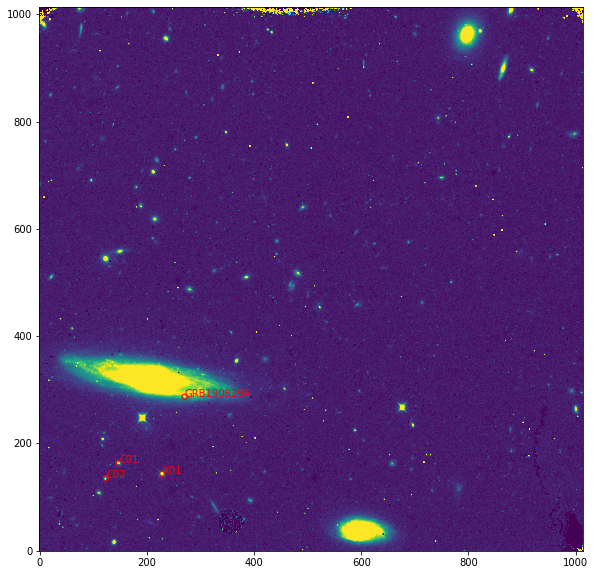

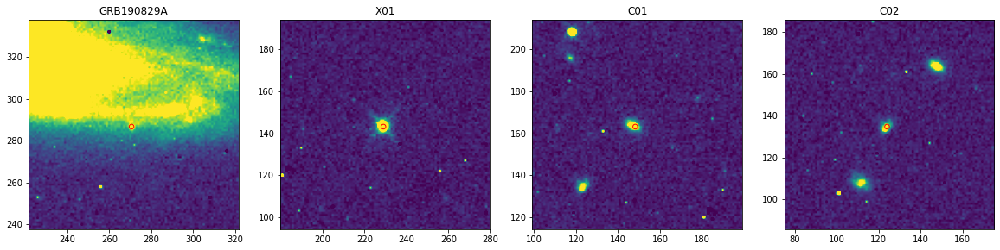

In [9]:
tmp = ds9file
sourcelist = read_ds9region(tmp)
tmpdata = fits.open(flist[0])[1].data
plt.figure(figsize=(10,10))
m = np.isfinite(tmpdata)
vmin,vmax = np.percentile(tmpdata[m],5.),np.percentile(tmpdata[m],99.)
plt.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)

for i in sourcelist:
    x,y = sourcelist[i]
    plt.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    plt.annotate(i,(x-1,y-1),fontsize=10,color='red')
    
n = len(sourcelist)
dx,dy = 50,50
fig = plt.figure(figsize=(5*n,5))
for i,ii in enumerate(sourcelist):
    x,y = sourcelist[ii]
    ax = fig.add_subplot(1,n,i+1)
    ax.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)
    ax.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    ax.set_xlim(x-dx,x+dx)
    ax.set_ylim(y-dy,y+dy)
    ax.set_title(ii,fontsize=12)
    

Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_trace.csv
Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_overview.pdf

Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_tbox.csv
Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_bbox.csv
Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_bbcorner.csv
Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_cutout.fits
Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_mask.fits
Save ./idwbk5lvq_X01_202001_G102/idwbk5lvq_X01_202001_G102_fullflat.fits
Update flatfielded ./idwbk5lvq_X01_202001_G102/idwbk5lvq_flt.fits
Save ./idwbk5lyq_X01_202001_G102/idwbk5lyq_X01_202001_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale =

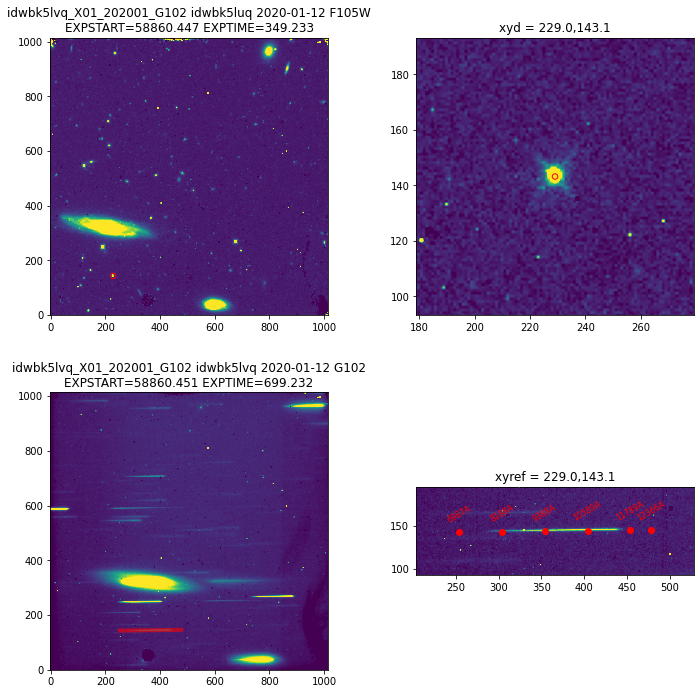

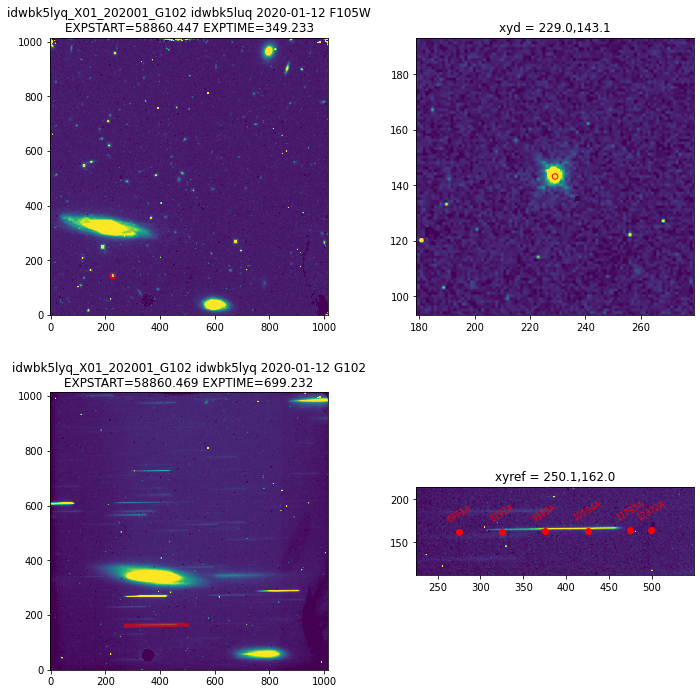

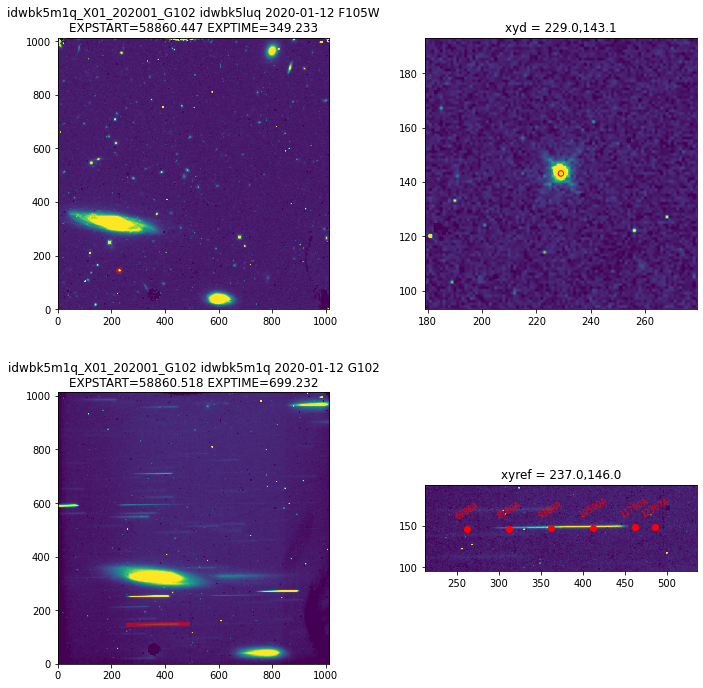

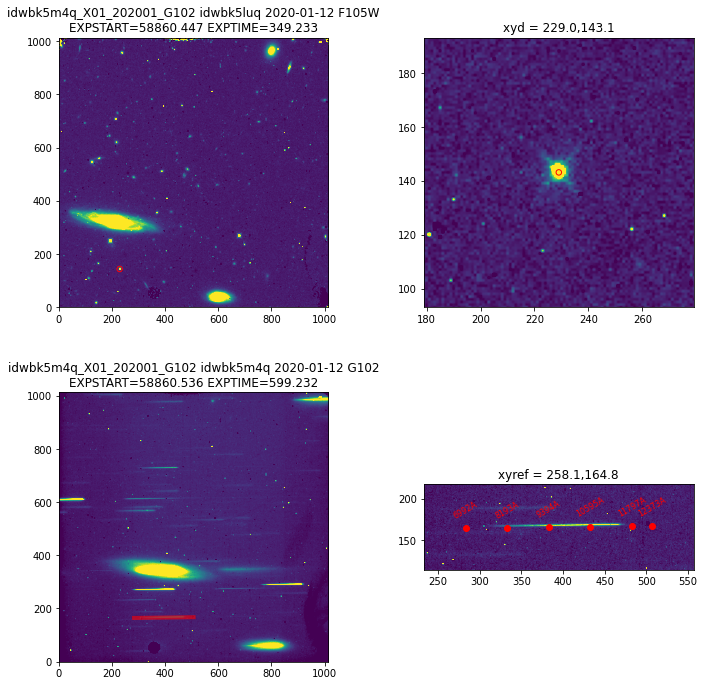

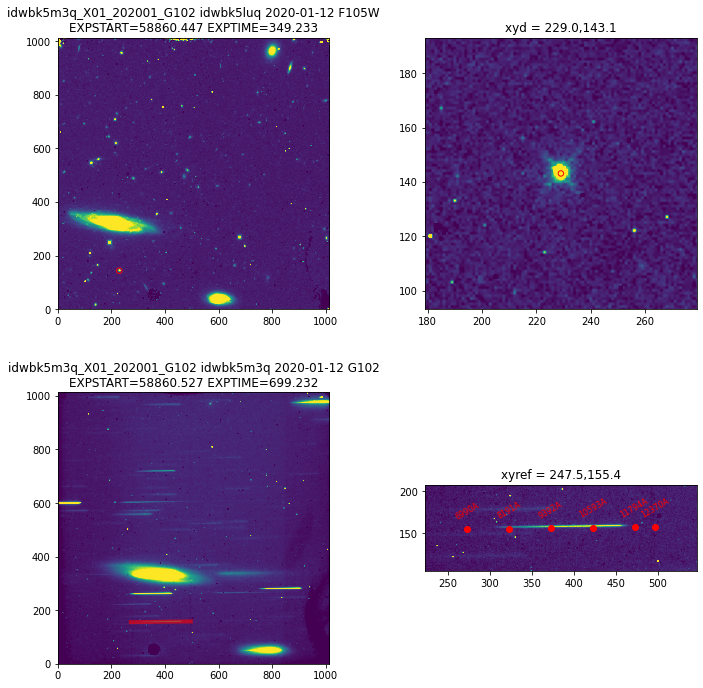

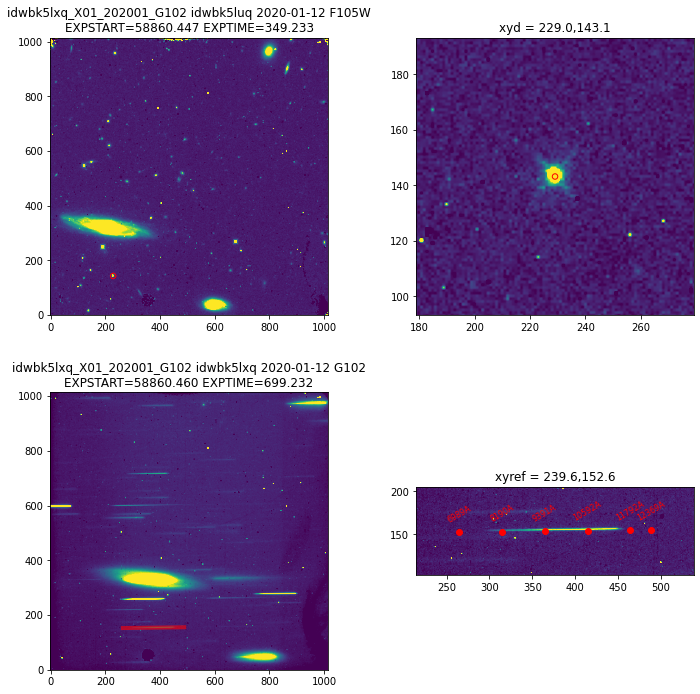

In [10]:
for i,ii in enumerate(flist):
    if i == 0:
        continue
    for j,jj in enumerate(sourcelist):
        if jj != sourcename:
            continue
        dfile = (flist[0],1)
        gfile = (flist[i],1)
        rootname = fits.open(gfile[0])[0].header['ROOTNAME']
        sourcename = jj
        saveprefix = '{0}_{1}'.format(rootname,identifier)
        savefolder = saveprefix
        plotformat = 'pdf'
        overwrite = False
        x,y = sourcelist[sourcename]
        xyd = (x-1,y-1)
        beam = 'A'
        params_overview = {'figsize': (10, 10), 
                           '221': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'fontsize': 12, 'title': 'default'}, 
                           '222': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'padxy': (50, 50), 'fontsize': 12, 'title': 'default'}, 
                           '223': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 4, 'alpha': 0.6, 'fontsize': 12, 'title': 'default'}, 
                           '224': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 0, 'alpha': 0.6, 'padxy': (50, 50), 'tickperx': 50, 'annotate_marker': 'ro', 'annotate_color': 'red', 'annotate_fontsize': 8, 'annotate_rotation': 30.0, 'fontsize': 12, 'title': 'default'}}
        generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                                   xyd,confile,beam,gfile,dfile,
                                   flatfile,
                               params_overview,filterobs
                                  )
        

In [11]:
# make drzlist
drzlist = []
for ii,i in enumerate(flist):
    if ii==0:
        continue
    tmp = i.split('/')[-1]
    tmpp = tmp.split('_')[0]
    string = './{0}_{1}/{2}'.format(tmpp,identifier,tmp)
    drzlist.append(string)
drzlist


['./idwbk5lvq_X01_202001_G102/idwbk5lvq_flt.fits',
 './idwbk5lyq_X01_202001_G102/idwbk5lyq_flt.fits',
 './idwbk5m1q_X01_202001_G102/idwbk5m1q_flt.fits',
 './idwbk5m4q_X01_202001_G102/idwbk5m4q_flt.fits',
 './idwbk5m3q_X01_202001_G102/idwbk5m3q_flt.fits',
 './idwbk5lxq_X01_202001_G102/idwbk5lxq_flt.fits']

In [12]:
# drizzle
params_drz = {'build':True,
          'restore':False,
          'overwrite':False,
          'clean':True,
          # Step 1 Statis Mask
          'static':False,
          # Step 2 Sky Sub
          'skysub':True,
          'skymethod':'localmin',
          'skystat':'median',
          # Step 3 Driz Sep
          'driz_separate':True,
          'driz_sep_kernel':'turbo',
          'driz_sep_pixfrac':1., # Set this high for CR
#           'driz_sep_scale':0.05, # Smaller than native size, better for CR
          # Step 4 Median
          'median':True,
          'combine_type':'median',
          'combine_nhigh':1, # Reject highest values before computing median, good for CR
          # Step 5 Blot
          'blot':True,
          'blot_interp':'poly5',
          'blot_addsky':True,
          # Step 6 CR
          'driz_cr':True,
          'driz_cr_corr':True,
          'driz_cr_ctegrow':0,
          # Step 7 Final Combine
          'driz_combine':True,
              'final_refimage':drzlist[0]
         }
AstroDrizzle(input=drzlist,
             output='{0}'.format(identifier),
             **params_drz
            )


Setting up logfile :  astrodrizzle.log
AstroDrizzle Version 3.1.6 (2020-02-19 16:16:30 -0500) started at: 15:30:55.256 (24/08/2020)

==== Processing Step  Initialization  started at  15:30:55.258 (24/08/2020)

Creating OUTPUT WCS from ./idwbk5lvq_X01_202001_G102/idwbk5lvq_flt.fits[1]
WCS Keywords

CD_11  CD_12: -1.853429273486e-06 -3.3563671027034e-05
CD_21  CD_22: -3.757139399491e-05 1.543166447338e-06
CRVAL    : 44.535928876384 -8.9662964459753
CRPIX    : 507.0 507.0
NAXIS    : 1014 1014
Plate Scale : 0.13542149465440026
ORIENTAT : -87.36754952931929
********************************************************************************
*
*  Estimated memory usage:  up to 117 Mb.
*  Output image size:       1014 X 1014 pixels. 
*  Output image file:       ~ 11 Mb. 
*  Cores available:         6
*
********************************************************************************
==== Processing Step Initialization finished at 15:30:56.409 (24/08/2020)
==== Processing Step  Static Mask  started

reference sky value for image '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk5m4q_X01_202001_G102/idwbk5m4q_flt.fits' is 376.1917749889024
reference sky value for image '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk5m3q_X01_202001_G102/idwbk5m3q_flt.fits' is 442.88065903435205
reference sky value for image '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk5lxq_X01_202001_G102/idwbk5lxq_flt.fits' is 442.5367779507901
Saving output median image to: 'X01_202001_G102_med.fits'
==== Processing Step Create Median finished at 15:30:59.280 (24/08/2020)
==== Processing Step  Blot  started at  15:30:59.28 (24/08/2020)

    Blot: creating blotted image:  /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk5lvq_X01_202001_G102/idwbk5lvq_flt.fits[sci,1]
Using default C-based coordinate transformation...
-Generating simple FITS output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk5lvq_X01_202001_G102/idwbk5lvq_sci1_blt.fits
Writing out image to disk: /Users/kbhirombhakdi/_work/Side

In [13]:
# setup for drzblot
drzfile = glob.glob('./{0}_drz.fits'.format(identifier))[0]
reffile = drzlist[0]
skyval = fits.open(reffile)[1].header['MDRIZSKY']
rootname = reffile.split('/')[-1].split('_')[0]
outdata = './drzblot_{0}/{1}_drzblot_sci.fits'.format(identifier,rootname)
drzfile,reffile,skyval,outdata


('./X01_202001_G102_drz.fits',
 './idwbk5lvq_X01_202001_G102/idwbk5lvq_flt.fits',
 0.6873870491981506,
 './drzblot_X01_202001_G102/idwbk5lvq_drzblot_sci.fits')

In [14]:
# facilitate creating folder
saveprefix = rootname
savefolder = 'drzblot_{0}'.format(identifier)
plotformat = 'pdf'
overwrite = False
containter_drzblot = Container(saveprefix,savefolder,plotformat,overwrite)
# blot
ablot.blot('{0}[1]'.format(drzfile),'{0}[1]'.format(reffile),addsky=False,skyval=skyval,
           outdata=outdata,in_units='counts',out_units='cps')
# replace back
os.system('cp {0} ./{1}/'.format(flist[1],savefolder))
string = './{0}/{1}'.format(savefolder,flist[1].split('/')[-1])
tmp = fits.open(string)
tmpp = fits.open(outdata)
tmp[1].data = tmpp[1].data.copy()
tmp.writeto(string,overwrite=True)


Using coordinate transformation defined by user...
Added 0.6873870491981506 counts back in to blotted image as sky.
Created output image: ./drzblot_X01_202001_G102/idwbk5lvq_drzblot_sci.fits


# 2. drzblot X01 G102 201909

In [23]:
# Set files
fpath = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/*k01*/*flt.fits'
tmp = np.array(glob.glob(fpath))
tlist = tmp
tlist = [tmp[0],tmp[2],tmp[1],tmp[3],tmp[5]]
for ii,i in enumerate(tlist):
    h = fits.open(i)[0].header
    hs = fits.open(i)[1].header
    string = '{0} {1} {2} {3} {4} {5} {6} {7} {8}'.format(ii,h['ROOTNAME'],h['FILTER'],h['EXPSTART'],h['SUBARRAY'],
                       h['POSTARG1'],h['POSTARG2'],hs['IDCSCALE'],h['DATE-OBS']
                      )
    print(string)
flist = copy.deepcopy(tlist)


0 idlk01jjq F110W 58754.1284439 False 0.0 0.0 0.1282500028610229 2019-09-28
1 idlk01jmq G102 58754.13229834 False 0.0 0.0 0.1282500028610229 2019-09-28
2 idlk01jrq G102 58754.1851802 False -0.20344 0.30304 0.1282500028610229 2019-09-28
3 idlk01joq G102 58754.1388376 False 0.54235 0.18176 0.1282500028610229 2019-09-28
4 idlk01jpq G102 58754.14537686 False 0.33891 0.48481 0.1282500028610229 2019-09-28


In [24]:
sourcename = 'X01'
confile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G102.cal.V4.32/G102.F110W.V4.32.conf'
flatfile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G102.cal.V4.32/WFC3.IR.G102.flat.2.fits'
dateobs = '201909'
filterobs = 'G102'
identifier = '{0}_{1}_{2}'.format(sourcename,dateobs,filterobs)
ds9file = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/idlk01jjq/idlk01jjq.reg'


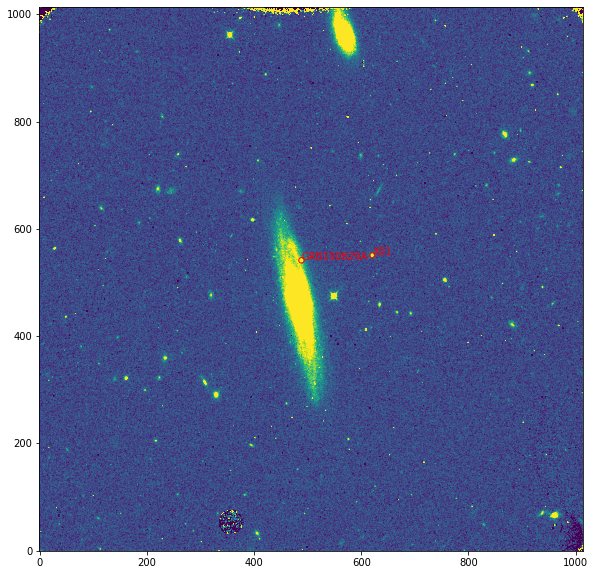

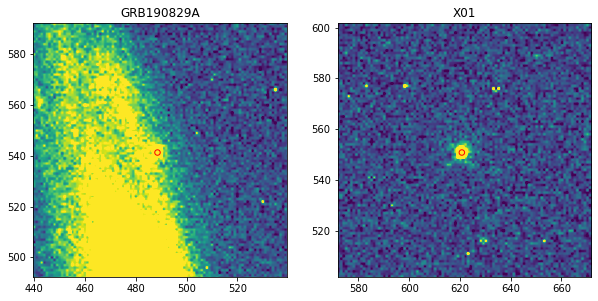

In [25]:
tmp = ds9file
sourcelist = read_ds9region(tmp)
tmpdata = fits.open(flist[0])[1].data
plt.figure(figsize=(10,10))
m = np.isfinite(tmpdata)
vmin,vmax = np.percentile(tmpdata[m],5.),np.percentile(tmpdata[m],99.)
plt.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)

for i in sourcelist:
    x,y = sourcelist[i]
    plt.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    plt.annotate(i,(x-1,y-1),fontsize=10,color='red')
    
n = len(sourcelist)
dx,dy = 50,50
fig = plt.figure(figsize=(5*n,5))
for i,ii in enumerate(sourcelist):
    x,y = sourcelist[ii]
    ax = fig.add_subplot(1,n,i+1)
    ax.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)
    ax.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    ax.set_xlim(x-dx,x+dx)
    ax.set_ylim(y-dy,y+dy)
    ax.set_title(ii,fontsize=12)
    

Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_trace.csv
Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_overview.pdf

Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_tbox.csv
Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_bbox.csv
Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_bbcorner.csv
Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_cutout.fits
Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_mask.fits
Save ./idlk01jmq_X01_201909_G102/idlk01jmq_X01_201909_G102_fullflat.fits
Update flatfielded ./idlk01jmq_X01_201909_G102/idlk01jmq_flt.fits
Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale =

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_trace.csv
Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_overview.pdf

Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_tbox.csv
Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_bbox.csv
Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_bbcorner.csv
Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_cutout.fits
Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_mask.fits
Save ./idlk01jrq_X01_201909_G102/idlk01jrq_X01_201909_G102_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk01jrq_X01_201909_G102/idlk01jrq_flt.fits
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_trace.csv
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_overview.pdf

Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_tbox.csv
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_bbox.csv
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_bbcorner.csv
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_cutout.fits
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_mask.fits
Save ./idlk01joq_X01_201909_G102/idlk01joq_X01_201909_G102_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk01joq_X01_201909_G102/idlk01joq_flt.fits
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_trace.csv
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_overview.pdf

Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_tbox.csv
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_bbox.csv
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_bbcorner.csv
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_cutout.fits
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_mask.fits
Save ./idlk01jpq_X01_201909_G102/idlk01jpq_X01_201909_G102_fullflat.fits
Update flatfielded ./idlk01jpq_X01_201909_G102/idlk01jpq_flt.fits
Setting up logfile :  astrodrizzle.log
AstroDrizzle Version 3.1.6 (2020-02-19 16:16:30 -0500) started at: 15

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: divide by zero encountered in true_divide
/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Creating OUTPUT WCS from ./idlk01jmq_X01_201909_G102/idlk01jmq_flt.fits[1]
WCS Keywords

CD_11  CD_12: 3.55874431413255e-05 1.10067261254017e-05
CD_21  CD_22: 1.22039593029989e-05 -3.1749628641053e-05
CRVAL    : 44.54406741220054 -8.956507658833223
CRPIX    : 507.0 507.0
NAXIS    : 1014 1014
Plate Scale : 0.1354386185945575
ORIENTAT : 160.87997048501853
********************************************************************************
*
*  Estimated memory usage:  up to 78 Mb.
*  Output image size:       1014 X 1014 pixels. 
*  Output image file:       ~ 11 Mb. 
*  Cores available:         4
*
********************************************************************************
==== Processing Step Initialization finished at 15:53:42.865 (24/08/2020)
==== Processing Step  Static Mask  started at  15:53:42.86 (24/08/2020)

==== Processing Step Static Mask finished at 15:53:42.870 (24/08/2020)
==== Processing Step  Subtract Sky  started at  15:53:42.871 (24/08/2020)

***** skymatch started on 2

Writing out image to disk: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk01jpq_X01_201909_G102/idlk01jpq_sci1_blt.fits
==== Processing Step Blot finished at 15:53:46.354 (24/08/2020)
==== Processing Step  Driz_CR  started at  15:53:46.356 (24/08/2020)

Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk01jmq_X01_201909_G102/idlk01jmq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk01jrq_X01_201909_G102/idlk01jrq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk01joq_X01_201909_G102/idlk01joq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk01jpq_X01_201909_G102/idlk01jpq_sci1_crmask.fits
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk01jmq_X01_201909_G102/idlk01jmq_crclean.fits'
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk01jrq_X01_201909_G102/idlk01jrq_crclean.fits'
Created CR corrected file: '/Us

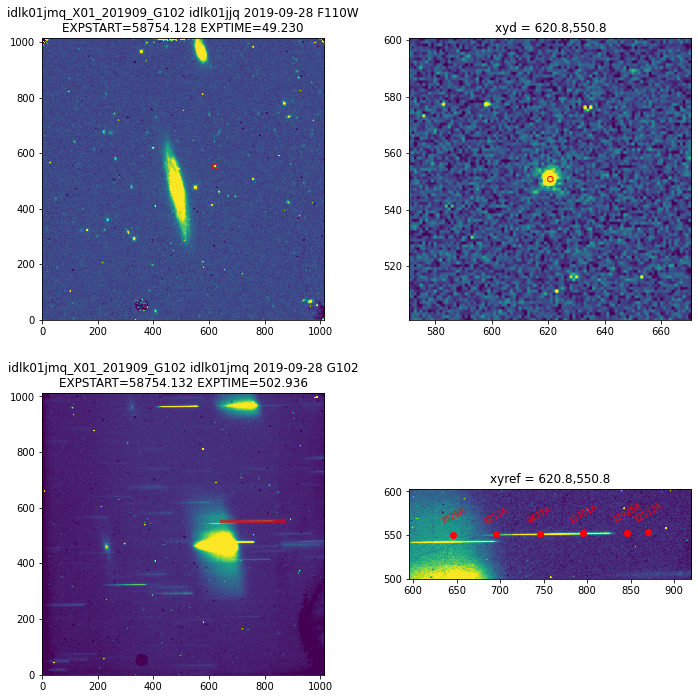

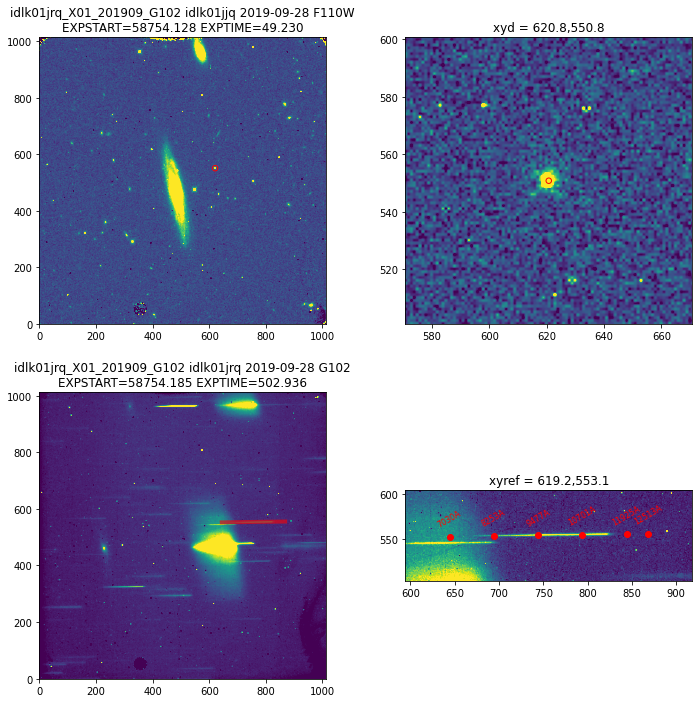

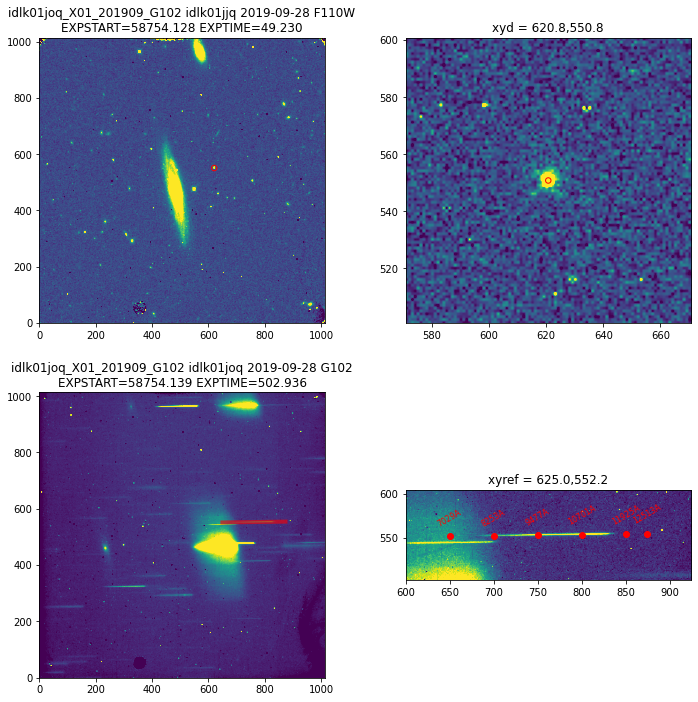

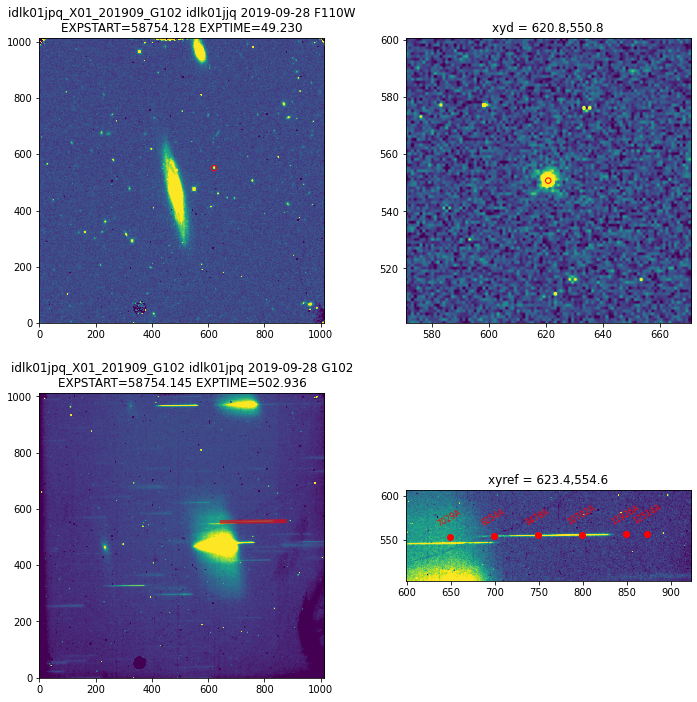

In [28]:
for i,ii in enumerate(flist):
    if i == 0:
        continue
    for j,jj in enumerate(sourcelist):
        if jj != sourcename:
            continue
        dfile = (flist[0],1)
        gfile = (flist[i],1)
        rootname = fits.open(gfile[0])[0].header['ROOTNAME']
        sourcename = jj
        saveprefix = '{0}_{1}'.format(rootname,identifier)
        savefolder = saveprefix
        plotformat = 'pdf'
        overwrite = False
        x,y = sourcelist[sourcename]
        xyd = (x-1,y-1)
        beam = 'A'
        params_overview = {'figsize': (10, 10), 
                           '221': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'fontsize': 12, 'title': 'default'}, 
                           '222': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'padxy': (50, 50), 'fontsize': 12, 'title': 'default'}, 
                           '223': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 4, 'alpha': 0.6, 'fontsize': 12, 'title': 'default'}, 
                           '224': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 0, 'alpha': 0.6, 'padxy': (50, 50), 'tickperx': 50, 'annotate_marker': 'ro', 'annotate_color': 'red', 'annotate_fontsize': 8, 'annotate_rotation': 30.0, 'fontsize': 12, 'title': 'default'}}
        generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                                   xyd,confile,beam,gfile,dfile,
                                   flatfile,
                               params_overview,filterobs
                                  )
# make drzlist
drzlist = []
for ii,i in enumerate(flist):
    if ii==0:
        continue
    tmp = i.split('/')[-1]
    tmpp = tmp.split('_')[0]
    string = './{0}_{1}/{2}'.format(tmpp,identifier,tmp)
    drzlist.append(string)
drzlist
# drizzle
params_drz = {'build':True,
          'restore':False,
          'overwrite':False,
          'clean':True,
          # Step 1 Statis Mask
          'static':False,
          # Step 2 Sky Sub
          'skysub':True,
          'skymethod':'localmin',
          'skystat':'median',
          # Step 3 Driz Sep
          'driz_separate':True,
          'driz_sep_kernel':'turbo',
          'driz_sep_pixfrac':1., # Set this high for CR
#           'driz_sep_scale':0.05, # Smaller than native size, better for CR
          # Step 4 Median
          'median':True,
          'combine_type':'median',
          'combine_nhigh':1, # Reject highest values before computing median, good for CR
          # Step 5 Blot
          'blot':True,
          'blot_interp':'poly5',
          'blot_addsky':True,
          # Step 6 CR
          'driz_cr':True,
          'driz_cr_corr':True,
          'driz_cr_ctegrow':0,
          # Step 7 Final Combine
          'driz_combine':True,
              'final_refimage':drzlist[0]
         }
AstroDrizzle(input=drzlist,
             output='{0}'.format(identifier),
             **params_drz
            )
# setup for drzblot
drzfile = glob.glob('./{0}_drz.fits'.format(identifier))[0]
reffile = drzlist[0]
skyval = fits.open(reffile)[1].header['MDRIZSKY']
rootname = reffile.split('/')[-1].split('_')[0]
outdata = './drzblot_{0}/{1}_drzblot_sci.fits'.format(identifier,rootname)
drzfile,reffile,skyval,outdata
# facilitate creating folder
saveprefix = rootname
savefolder = 'drzblot_{0}'.format(identifier)
plotformat = 'pdf'
overwrite = False
containter_drzblot = Container(saveprefix,savefolder,plotformat,overwrite)
# blot
ablot.blot('{0}[1]'.format(drzfile),'{0}[1]'.format(reffile),addsky=False,skyval=skyval,
           outdata=outdata,in_units='counts',out_units='cps')
# replace back
os.system('cp {0} ./{1}/'.format(flist[1],savefolder))
string = './{0}/{1}'.format(savefolder,flist[1].split('/')[-1])
tmp = fits.open(string)
tmpp = fits.open(outdata)
tmp[1].data = tmpp[1].data.copy()
tmp.writeto(string,overwrite=True)


# 3. drzblot X01 201910 G102

In [29]:
# Set files
fpath = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/*k03*/*flt.fits'
tmp = np.array(glob.glob(fpath))
tlist = tmp
tlist = [tmp[4],tmp[1],tmp[0],tmp[5],tmp[6]]
for ii,i in enumerate(tlist):
    h = fits.open(i)[0].header
    hs = fits.open(i)[1].header
    string = '{0} {1} {2} {3} {4} {5} {6} {7} {8}'.format(ii,h['ROOTNAME'],h['FILTER'],h['EXPSTART'],h['SUBARRAY'],
                       h['POSTARG1'],h['POSTARG2'],hs['IDCSCALE'],h['DATE-OBS']
                      )
    print(string)
flist = copy.deepcopy(tlist)


0 idlk03azq F110W 58782.65431288 False 0.0 0.0 0.1282500028610229 2019-10-26
1 idlk03b2q G102 58782.65816695 False 0.0 0.0 0.1282500028610229 2019-10-26
2 idlk03b5q G102 58782.67124584 False 0.33891 0.48481 0.1282500028610229 2019-10-26
3 idlk03b7q G102 58782.6777851 False -0.20344 0.30304 0.1282500028610229 2019-10-26
4 idlk03b4q G102 58782.66470658 False 0.54235 0.18176 0.1282500028610229 2019-10-26


In [30]:
sourcename = 'X01'
confile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G102.cal.V4.32/G102.F110W.V4.32.conf'
flatfile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G102.cal.V4.32/WFC3.IR.G102.flat.2.fits'
dateobs = '201910'
filterobs = 'G102'
identifier = '{0}_{1}_{2}'.format(sourcename,dateobs,filterobs)
ds9file = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/idlk03azq/idlk03azq.reg'


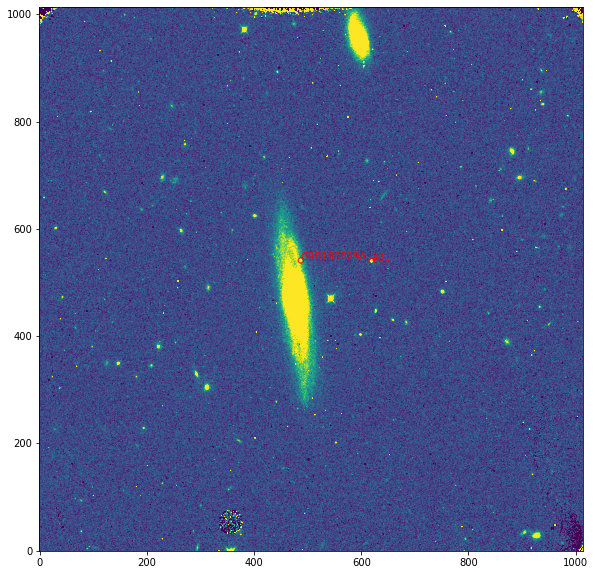

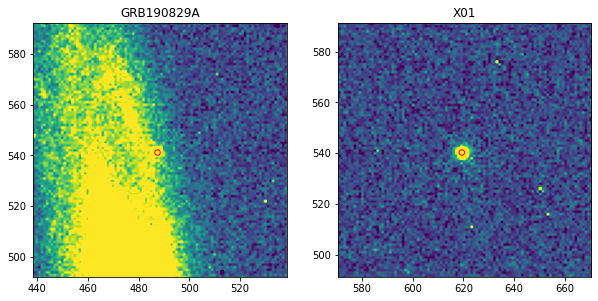

In [31]:
tmp = ds9file
sourcelist = read_ds9region(tmp)
tmpdata = fits.open(flist[0])[1].data
plt.figure(figsize=(10,10))
m = np.isfinite(tmpdata)
vmin,vmax = np.percentile(tmpdata[m],5.),np.percentile(tmpdata[m],99.)
plt.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)

for i in sourcelist:
    x,y = sourcelist[i]
    plt.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    plt.annotate(i,(x-1,y-1),fontsize=10,color='red')
    
n = len(sourcelist)
dx,dy = 50,50
fig = plt.figure(figsize=(5*n,5))
for i,ii in enumerate(sourcelist):
    x,y = sourcelist[ii]
    ax = fig.add_subplot(1,n,i+1)
    ax.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)
    ax.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    ax.set_xlim(x-dx,x+dx)
    ax.set_ylim(y-dy,y+dy)
    ax.set_title(ii,fontsize=12)
    

Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_trace.csv
Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_overview.pdf

Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_tbox.csv
Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_bbox.csv
Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_bbcorner.csv
Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_cutout.fits
Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_mask.fits
Save ./idlk03b2q_X01_201910_G102/idlk03b2q_X01_201910_G102_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk03b2q_X01_201910_G102/idlk03b2q_flt.fits
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_trace.csv
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_overview.pdf

Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_tbox.csv
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_bbox.csv
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_bbcorner.csv
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_cutout.fits
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_mask.fits
Save ./idlk03b5q_X01_201910_G102/idlk03b5q_X01_201910_G102_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk03b5q_X01_201910_G102/idlk03b5q_flt.fits
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_trace.csv
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_overview.pdf

Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_tbox.csv
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_bbox.csv
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_bbcorner.csv
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_cutout.fits
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_mask.fits
Save ./idlk03b7q_X01_201910_G102/idlk03b7q_X01_201910_G102_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk03b7q_X01_201910_G102/idlk03b7q_flt.fits
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_trace.csv
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_overview.pdf

Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_tbox.csv
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_bbox.csv
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_bbcorner.csv
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_cutout.fits
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_mask.fits
Save ./idlk03b4q_X01_201910_G102/idlk03b4q_X01_201910_G102_fullflat.fits
Update flatfielded ./idlk03b4q_X01_201910_G102/idlk03b4q_flt.fits
Setting up logfile :  astrodrizzle.log
AstroDrizzle Version 3.1.6 (2020-02-19 16:16:30 -0500) started at: 15

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Creating OUTPUT WCS from ./idlk03b2q_X01_201910_G102/idlk03b2q_flt.fits[1]
WCS Keywords

CD_11  CD_12: 3.63872061998015e-05 8.64339258111947e-06
CD_21  CD_22: 9.55531576021472e-06 -3.247187906982e-05
CRVAL    : 44.54419956354905 -8.956511304615452
CRPIX    : 507.0 507.0
NAXIS    : 1014 1014
Plate Scale : 0.13543527432904426
ORIENTAT : 165.0945728804629
********************************************************************************
*
*  Estimated memory usage:  up to 78 Mb.
*  Output image size:       1014 X 1014 pixels. 
*  Output image file:       ~ 11 Mb. 
*  Cores available:         4
*
********************************************************************************
==== Processing Step Initialization finished at 15:57:30.270 (24/08/2020)
==== Processing Step  Static Mask  started at  15:57:30.272 (24/08/2020)

==== Processing Step Static Mask finished at 15:57:30.274 (24/08/2020)
==== Processing Step  Subtract Sky  started at  15:57:30.275 (24/08/2020)

***** skymatch started on 2

Writing out image to disk: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk03b4q_X01_201910_G102/idlk03b4q_sci1_blt.fits
==== Processing Step Blot finished at 15:57:33.760 (24/08/2020)
==== Processing Step  Driz_CR  started at  15:57:33.762 (24/08/2020)

Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk03b5q_X01_201910_G102/idlk03b5q_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk03b2q_X01_201910_G102/idlk03b2q_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk03b7q_X01_201910_G102/idlk03b7q_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk03b4q_X01_201910_G102/idlk03b4q_sci1_crmask.fits
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk03b5q_X01_201910_G102/idlk03b5q_crclean.fits'
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk03b2q_X01_201910_G102/idlk03b2q_crclean.fits'
Created CR corrected file: '/Us

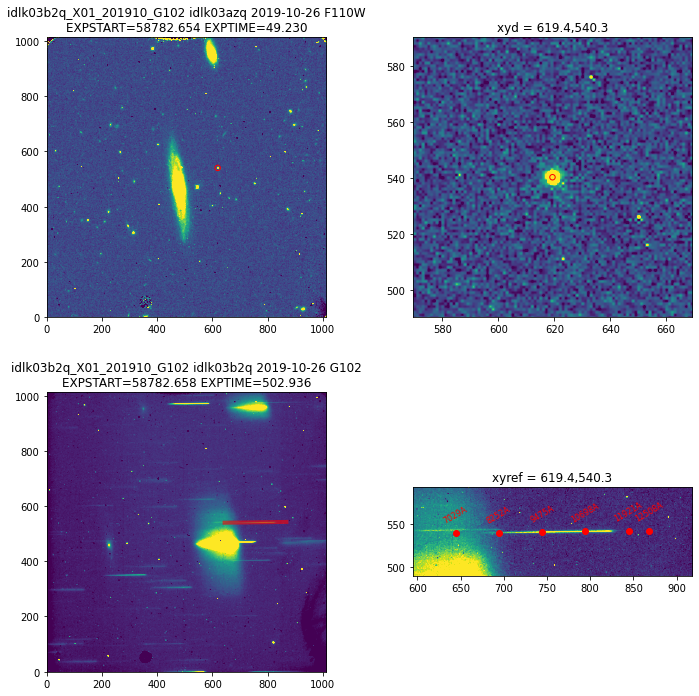

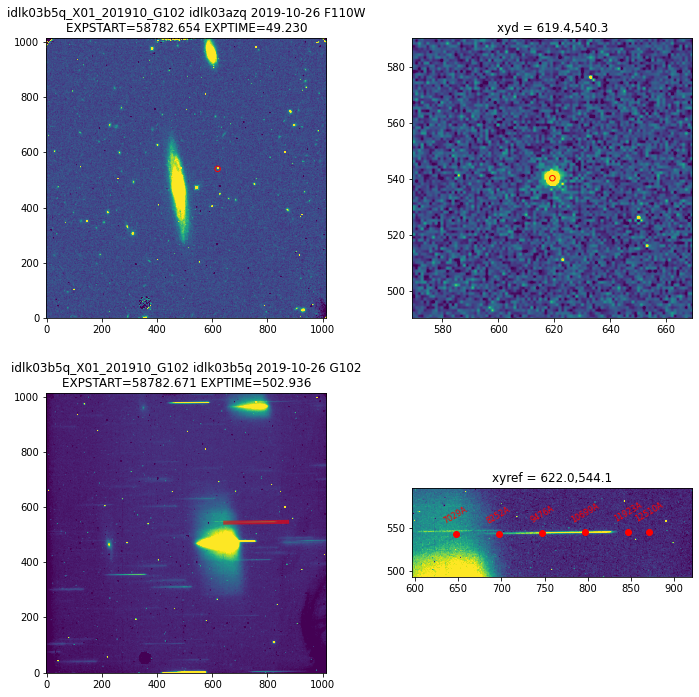

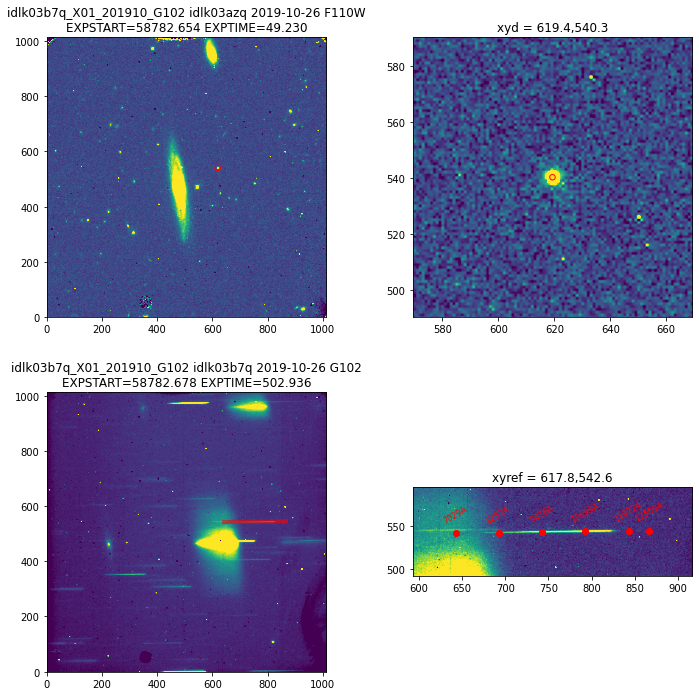

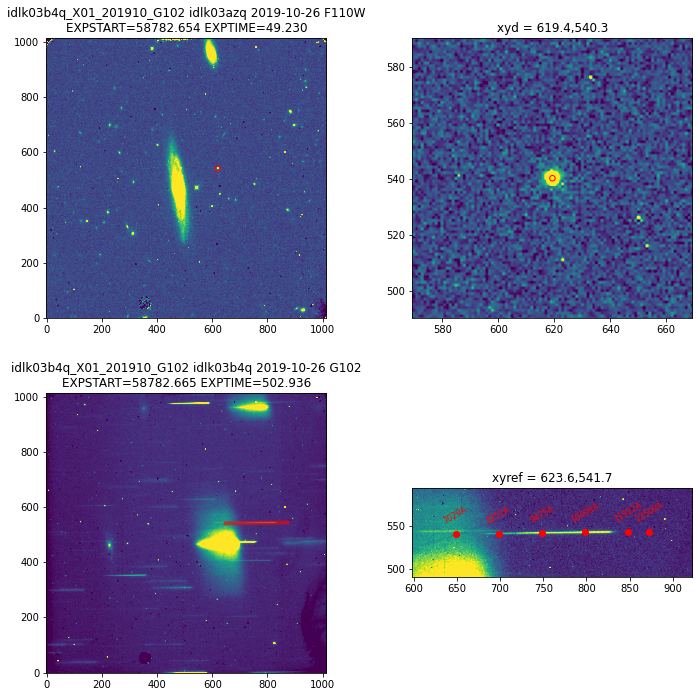

In [32]:
for i,ii in enumerate(flist):
    if i == 0:
        continue
    for j,jj in enumerate(sourcelist):
        if jj != sourcename:
            continue
        dfile = (flist[0],1)
        gfile = (flist[i],1)
        rootname = fits.open(gfile[0])[0].header['ROOTNAME']
        sourcename = jj
        saveprefix = '{0}_{1}'.format(rootname,identifier)
        savefolder = saveprefix
        plotformat = 'pdf'
        overwrite = False
        x,y = sourcelist[sourcename]
        xyd = (x-1,y-1)
        beam = 'A'
        params_overview = {'figsize': (10, 10), 
                           '221': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'fontsize': 12, 'title': 'default'}, 
                           '222': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'padxy': (50, 50), 'fontsize': 12, 'title': 'default'}, 
                           '223': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 4, 'alpha': 0.6, 'fontsize': 12, 'title': 'default'}, 
                           '224': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 0, 'alpha': 0.6, 'padxy': (50, 50), 'tickperx': 50, 'annotate_marker': 'ro', 'annotate_color': 'red', 'annotate_fontsize': 8, 'annotate_rotation': 30.0, 'fontsize': 12, 'title': 'default'}}
        generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                                   xyd,confile,beam,gfile,dfile,
                                   flatfile,
                               params_overview,filterobs
                                  )
# make drzlist
drzlist = []
for ii,i in enumerate(flist):
    if ii==0:
        continue
    tmp = i.split('/')[-1]
    tmpp = tmp.split('_')[0]
    string = './{0}_{1}/{2}'.format(tmpp,identifier,tmp)
    drzlist.append(string)
drzlist
# drizzle
params_drz = {'build':True,
          'restore':False,
          'overwrite':False,
          'clean':True,
          # Step 1 Statis Mask
          'static':False,
          # Step 2 Sky Sub
          'skysub':True,
          'skymethod':'localmin',
          'skystat':'median',
          # Step 3 Driz Sep
          'driz_separate':True,
          'driz_sep_kernel':'turbo',
          'driz_sep_pixfrac':1., # Set this high for CR
#           'driz_sep_scale':0.05, # Smaller than native size, better for CR
          # Step 4 Median
          'median':True,
          'combine_type':'median',
          'combine_nhigh':1, # Reject highest values before computing median, good for CR
          # Step 5 Blot
          'blot':True,
          'blot_interp':'poly5',
          'blot_addsky':True,
          # Step 6 CR
          'driz_cr':True,
          'driz_cr_corr':True,
          'driz_cr_ctegrow':0,
          # Step 7 Final Combine
          'driz_combine':True,
              'final_refimage':drzlist[0]
         }
AstroDrizzle(input=drzlist,
             output='{0}'.format(identifier),
             **params_drz
            )
# setup for drzblot
drzfile = glob.glob('./{0}_drz.fits'.format(identifier))[0]
reffile = drzlist[0]
skyval = fits.open(reffile)[1].header['MDRIZSKY']
rootname = reffile.split('/')[-1].split('_')[0]
outdata = './drzblot_{0}/{1}_drzblot_sci.fits'.format(identifier,rootname)
drzfile,reffile,skyval,outdata
# facilitate creating folder
saveprefix = rootname
savefolder = 'drzblot_{0}'.format(identifier)
plotformat = 'pdf'
overwrite = False
containter_drzblot = Container(saveprefix,savefolder,plotformat,overwrite)
# blot
ablot.blot('{0}[1]'.format(drzfile),'{0}[1]'.format(reffile),addsky=False,skyval=skyval,
           outdata=outdata,in_units='counts',out_units='cps')
# replace back
os.system('cp {0} ./{1}/'.format(flist[1],savefolder))
string = './{0}/{1}'.format(savefolder,flist[1].split('/')[-1])
tmp = fits.open(string)
tmpp = fits.open(outdata)
tmp[1].data = tmpp[1].data.copy()
tmp.writeto(string,overwrite=True)


# 4. drzblot X01 201911 G141

In [33]:
# Set files
fpath = '/Users/kbhirombhakdi/_work/_data/15510/mastDownload/HST/*bk4*/*flt.fits'
tmp = np.array(glob.glob(fpath))
tlist = tmp
tlist = [tmp[7],tmp[4],tmp[1],tmp[2],tmp[3],tmp[5],tmp[6]]
for ii,i in enumerate(tlist):
    h = fits.open(i)[0].header
    hs = fits.open(i)[1].header
    string = '{0} {1} {2} {3} {4} {5} {6} {7} {8}'.format(ii,h['ROOTNAME'],h['FILTER'],h['EXPSTART'],h['SUBARRAY'],
                       h['POSTARG1'],h['POSTARG2'],hs['IDCSCALE'],h['DATE-OBS']
                      )
    print(string)
flist = copy.deepcopy(tlist)


0 idwbk4czq F140W 58817.67793892 False -28.613661 -32.611141 0.1282500028610229 2019-11-30
1 idwbk4d0q G141 58817.68238336 False -28.613661 -32.611141 0.1282500028610229 2019-11-30
2 idwbk4d6q G141 58817.74899225 False -27.596661 -32.248138 0.1282500028610229 2019-11-30
3 idwbk4d2q G141 58817.69121447 False -27.26066 -31.40214 0.1282500028610229 2019-11-30
4 idwbk4d8q G141 58817.75782336 False -26.24366 -31.039141 0.1282500028610229 2019-11-30
5 idwbk4d3q G141 58817.70004558 False -25.90766 -30.19314 0.1282500028610229 2019-11-30
6 idwbk4d9q G141 58817.76665447 False -24.890659 -29.827141 0.1282500028610229 2019-11-30


In [34]:
sourcename = 'X01'
confile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/G141.F140W.V4.32.conf'
flatfile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/WFC3.IR.G141.flat.2.fits'
dateobs = '201911'
filterobs = 'G141'
identifier = '{0}_{1}_{2}'.format(sourcename,dateobs,filterobs)
ds9file = '/Users/kbhirombhakdi/_work/_data/15510/mastDownload/HST/idwbk4czq/idwbk4czq.reg'


Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_trace.csv
Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_overview.pdf

Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_tbox.csv
Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_bbox.csv
Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_bbcorner.csv
Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_cutout.fits
Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_mask.fits
Save ./idwbk4d0q_X01_201911_G141/idwbk4d0q_X01_201911_G141_fullflat.fits
Update flatfielded ./idwbk4d0q_X01_201911_G141/idwbk4d0q_flt.fits
Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale =

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_trace.csv
Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_overview.pdf

Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_tbox.csv
Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_bbox.csv
Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_bbcorner.csv
Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_cutout.fits
Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_mask.fits
Save ./idwbk4d6q_X01_201911_G141/idwbk4d6q_X01_201911_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk4d6q_X01_201911_G141/idwbk4d6q_flt.fits
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_trace.csv
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_overview.pdf

Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_tbox.csv
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_bbox.csv
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_bbcorner.csv
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_cutout.fits
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_mask.fits
Save ./idwbk4d2q_X01_201911_G141/idwbk4d2q_X01_201911_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk4d2q_X01_201911_G141/idwbk4d2q_flt.fits
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_trace.csv
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_overview.pdf

Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_tbox.csv
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_bbox.csv
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_bbcorner.csv
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_cutout.fits
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_mask.fits
Save ./idwbk4d8q_X01_201911_G141/idwbk4d8q_X01_201911_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk4d8q_X01_201911_G141/idwbk4d8q_flt.fits
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_trace.csv
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_overview.pdf

Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_tbox.csv
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_bbox.csv
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_bbcorner.csv
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_cutout.fits
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_mask.fits
Save ./idwbk4d3q_X01_201911_G141/idwbk4d3q_X01_201911_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: divide by zero encountered in true_divide
/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk4d3q_X01_201911_G141/idwbk4d3q_flt.fits
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_trace.csv
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_overview.pdf

Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_tbox.csv
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_bbox.csv
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_bbcorner.csv
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_cutout.fits
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_mask.fits
Save ./idwbk4d9q_X01_201911_G141/idwbk4d9q_X01_201911_G141_fullflat.fits
Update flatfielded ./idwbk4d9q_X01_201911_G141/idwbk4d9q_flt.fits
Setting up logfile :  astrodrizzle.log
AstroDrizzle Version 3.1.6 (2020-02-19 16:16:30 -0500) started at: 16

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Creating OUTPUT WCS from ./idwbk4d0q_X01_201911_G141/idwbk4d0q_flt.fits[1]
WCS Keywords

CD_11  CD_12: -1.8535098079544e-06 -3.356512942226e-05
CD_21  CD_22: -3.7573026532114e-05 1.54323350039e-06
CRVAL    : 44.535928876384 -8.9662964459753
CRPIX    : 507.0 507.0
NAXIS    : 1014 1014
Plate Scale : 0.13542737893509194
ORIENTAT : -87.36754952931935
********************************************************************************
*
*  Estimated memory usage:  up to 117 Mb.
*  Output image size:       1014 X 1014 pixels. 
*  Output image file:       ~ 11 Mb. 
*  Cores available:         6
*
********************************************************************************
==== Processing Step Initialization finished at 16:05:14.871 (24/08/2020)
==== Processing Step  Static Mask  started at  16:05:14.873 (24/08/2020)

==== Processing Step Static Mask finished at 16:05:14.876 (24/08/2020)
==== Processing Step  Subtract Sky  started at  16:05:14.877 (24/08/2020)

***** skymatch started on 2020-0

reference sky value for image '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk4d9q_X01_201911_G141/idwbk4d9q_flt.fits' is 659.9197543385127
Saving output median image to: 'X01_201911_G141_med.fits'
==== Processing Step Create Median finished at 16:05:17.667 (24/08/2020)
==== Processing Step  Blot  started at  16:05:17.670 (24/08/2020)

    Blot: creating blotted image:  /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk4d0q_X01_201911_G141/idwbk4d0q_flt.fits[sci,1]
Using default C-based coordinate transformation...
-Generating simple FITS output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk4d0q_X01_201911_G141/idwbk4d0q_sci1_blt.fits
Writing out image to disk: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk4d0q_X01_201911_G141/idwbk4d0q_sci1_blt.fits
    Blot: creating blotted image:  /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk4d6q_X01_201911_G141/idwbk4d6q_flt.fits[sci,1]
Using default C-based coordinate transformation...
-Generating simple FITS output: /Users/

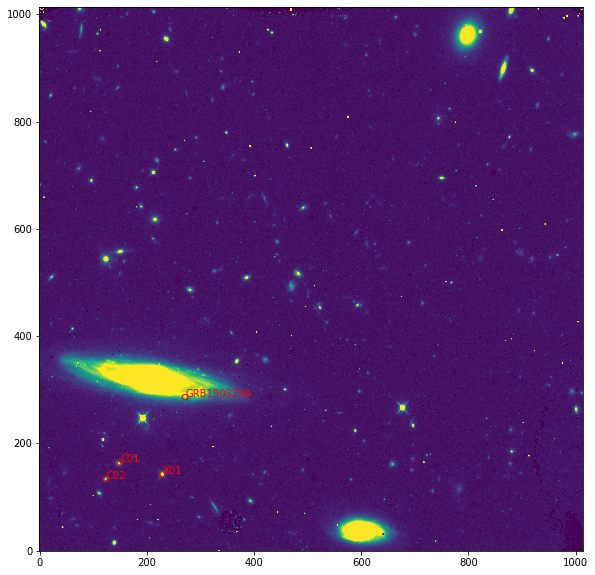

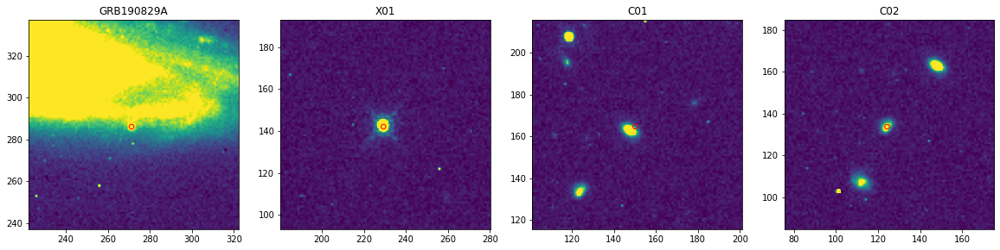

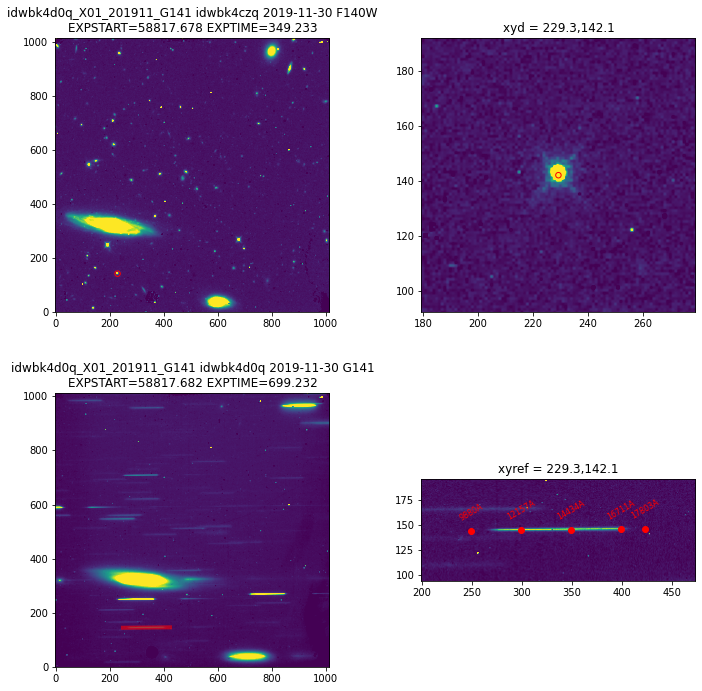

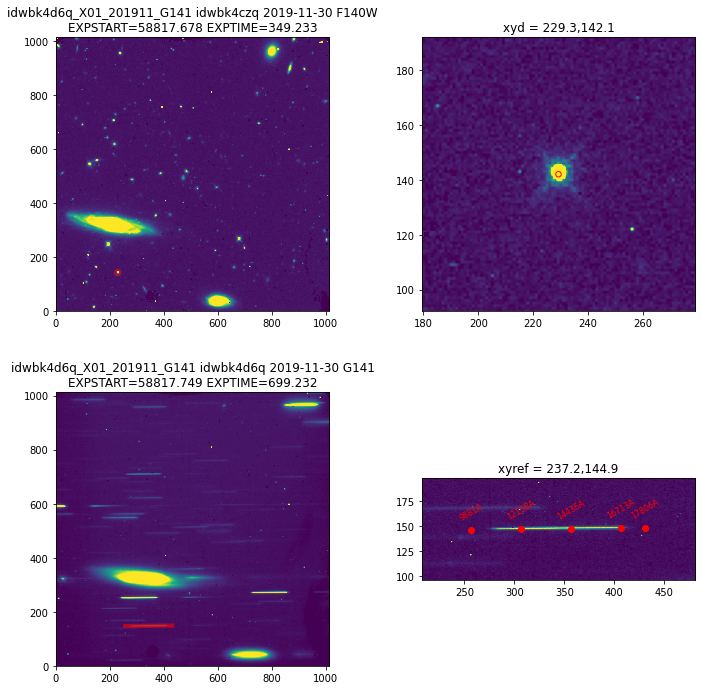

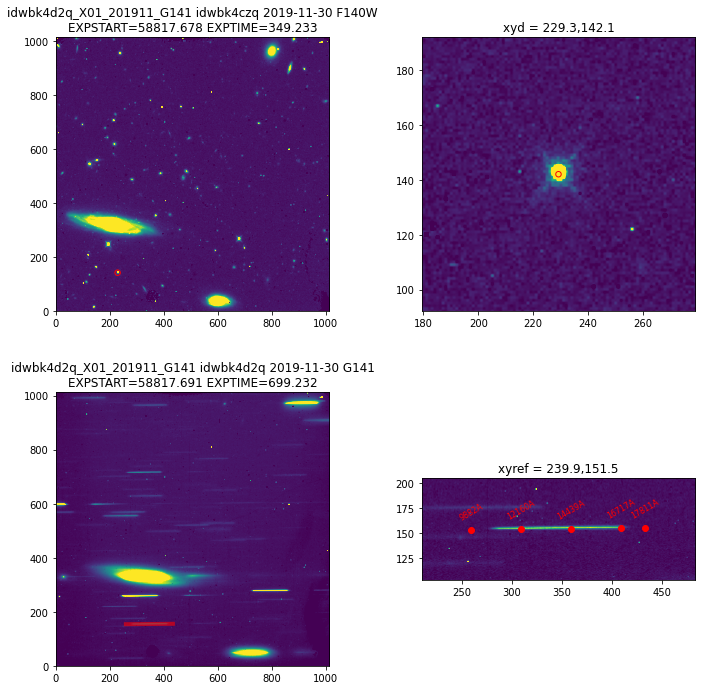

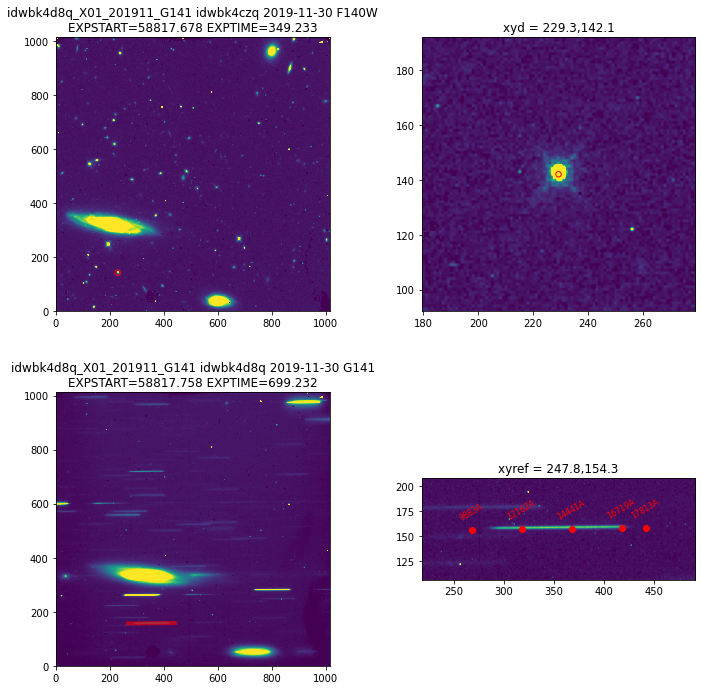

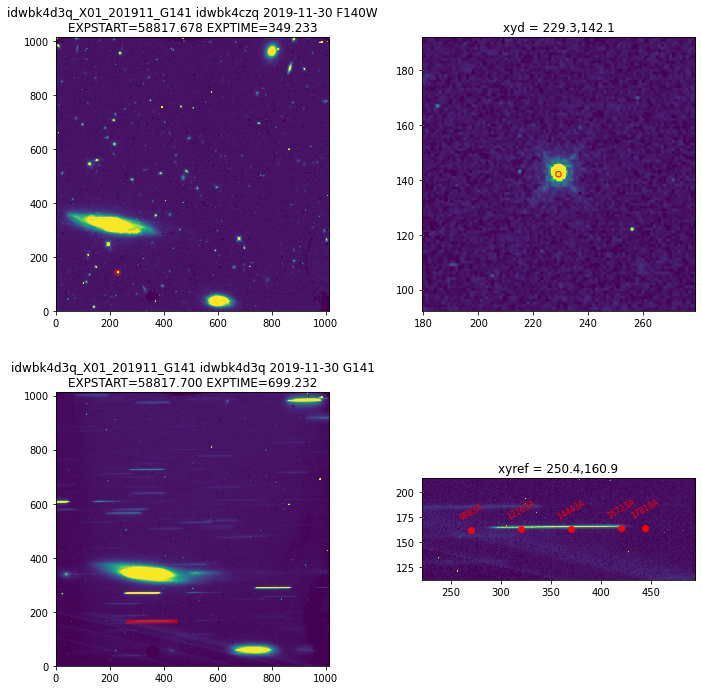

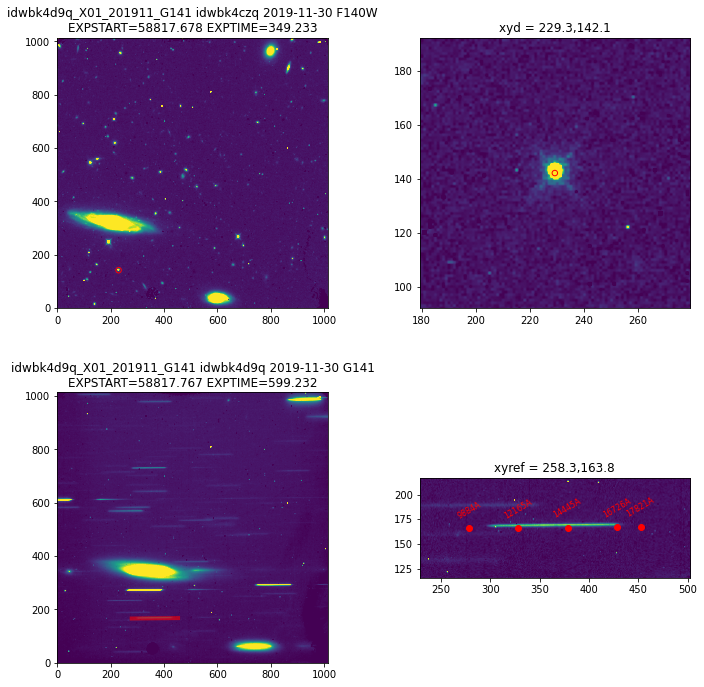

In [35]:
tmp = ds9file
sourcelist = read_ds9region(tmp)
tmpdata = fits.open(flist[0])[1].data
plt.figure(figsize=(10,10))
m = np.isfinite(tmpdata)
vmin,vmax = np.percentile(tmpdata[m],5.),np.percentile(tmpdata[m],99.)
plt.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)

for i in sourcelist:
    x,y = sourcelist[i]
    plt.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    plt.annotate(i,(x-1,y-1),fontsize=10,color='red')
    
n = len(sourcelist)
dx,dy = 50,50
fig = plt.figure(figsize=(5*n,5))
for i,ii in enumerate(sourcelist):
    x,y = sourcelist[ii]
    ax = fig.add_subplot(1,n,i+1)
    ax.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)
    ax.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    ax.set_xlim(x-dx,x+dx)
    ax.set_ylim(y-dy,y+dy)
    ax.set_title(ii,fontsize=12)
for i,ii in enumerate(flist):
    if i == 0:
        continue
    for j,jj in enumerate(sourcelist):
        if jj != sourcename:
            continue
        dfile = (flist[0],1)
        gfile = (flist[i],1)
        rootname = fits.open(gfile[0])[0].header['ROOTNAME']
        sourcename = jj
        saveprefix = '{0}_{1}'.format(rootname,identifier)
        savefolder = saveprefix
        plotformat = 'pdf'
        overwrite = False
        x,y = sourcelist[sourcename]
        xyd = (x-1,y-1)
        beam = 'A'
        params_overview = {'figsize': (10, 10), 
                           '221': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'fontsize': 12, 'title': 'default'}, 
                           '222': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'padxy': (50, 50), 'fontsize': 12, 'title': 'default'}, 
                           '223': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 4, 'alpha': 0.6, 'fontsize': 12, 'title': 'default'}, 
                           '224': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 0, 'alpha': 0.6, 'padxy': (50, 50), 'tickperx': 50, 'annotate_marker': 'ro', 'annotate_color': 'red', 'annotate_fontsize': 8, 'annotate_rotation': 30.0, 'fontsize': 12, 'title': 'default'}}
        generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                                   xyd,confile,beam,gfile,dfile,
                                   flatfile,
                               params_overview,filterobs
                                  )
# make drzlist
drzlist = []
for ii,i in enumerate(flist):
    if ii==0:
        continue
    tmp = i.split('/')[-1]
    tmpp = tmp.split('_')[0]
    string = './{0}_{1}/{2}'.format(tmpp,identifier,tmp)
    drzlist.append(string)
drzlist
# drizzle
params_drz = {'build':True,
          'restore':False,
          'overwrite':False,
          'clean':True,
          # Step 1 Statis Mask
          'static':False,
          # Step 2 Sky Sub
          'skysub':True,
          'skymethod':'localmin',
          'skystat':'median',
          # Step 3 Driz Sep
          'driz_separate':True,
          'driz_sep_kernel':'turbo',
          'driz_sep_pixfrac':1., # Set this high for CR
#           'driz_sep_scale':0.05, # Smaller than native size, better for CR
          # Step 4 Median
          'median':True,
          'combine_type':'median',
          'combine_nhigh':1, # Reject highest values before computing median, good for CR
          # Step 5 Blot
          'blot':True,
          'blot_interp':'poly5',
          'blot_addsky':True,
          # Step 6 CR
          'driz_cr':True,
          'driz_cr_corr':True,
          'driz_cr_ctegrow':0,
          # Step 7 Final Combine
          'driz_combine':True,
              'final_refimage':drzlist[0]
         }
AstroDrizzle(input=drzlist,
             output='{0}'.format(identifier),
             **params_drz
            )
# setup for drzblot
drzfile = glob.glob('./{0}_drz.fits'.format(identifier))[0]
reffile = drzlist[0]
skyval = fits.open(reffile)[1].header['MDRIZSKY']
rootname = reffile.split('/')[-1].split('_')[0]
outdata = './drzblot_{0}/{1}_drzblot_sci.fits'.format(identifier,rootname)
drzfile,reffile,skyval,outdata
# facilitate creating folder
saveprefix = rootname
savefolder = 'drzblot_{0}'.format(identifier)
plotformat = 'pdf'
overwrite = False
containter_drzblot = Container(saveprefix,savefolder,plotformat,overwrite)
# blot
ablot.blot('{0}[1]'.format(drzfile),'{0}[1]'.format(reffile),addsky=False,skyval=skyval,
           outdata=outdata,in_units='counts',out_units='cps')
# replace back
os.system('cp {0} ./{1}/'.format(flist[1],savefolder))
string = './{0}/{1}'.format(savefolder,flist[1].split('/')[-1])
tmp = fits.open(string)
tmpp = fits.open(outdata)
tmp[1].data = tmpp[1].data.copy()
tmp.writeto(string,overwrite=True)


# 5. drzblot X01 202001 G141

In [36]:
# Set files
fpath = '/Users/kbhirombhakdi/_work/_data/15510/mastDownload/HST/*bk6*/*flt.fits'
tmp = np.array(glob.glob(fpath))
tlist = tmp
tlist = [tmp[5],tmp[2],tmp[0],tmp[1],tmp[4],tmp[6],tmp[7]]
for ii,i in enumerate(tlist):
    h = fits.open(i)[0].header
    hs = fits.open(i)[1].header
    string = '{0} {1} {2} {3} {4} {5} {6} {7} {8}'.format(ii,h['ROOTNAME'],h['FILTER'],h['EXPSTART'],h['SUBARRAY'],
                       h['POSTARG1'],h['POSTARG2'],hs['IDCSCALE'],h['DATE-OBS']
                      )
    print(string)
flist = copy.deepcopy(tlist)


0 idwbk6m6q F140W 58860.57928236 False -28.613661 -32.611141 0.1282500028610229 2020-01-12
1 idwbk6m7q G141 58860.5837268 False -28.613661 -32.611141 0.1282500028610229 2020-01-12
2 idwbk6mhq G141 58860.65918976 False -26.24366 -31.039141 0.1282500028610229 2020-01-12
3 idwbk6m9q G141 58860.59255791 False -27.26066 -31.40214 0.1282500028610229 2020-01-12
4 idwbk6mfq G141 58860.65035902 False -27.596661 -32.248138 0.1282500028610229 2020-01-12
5 idwbk6mcq G141 58860.60138902 False -25.90766 -30.19314 0.1282500028610229 2020-01-12
6 idwbk6miq G141 58860.66802087 False -24.890659 -29.827141 0.1282500028610229 2020-01-12


In [37]:
sourcename = 'X01'
confile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/G141.F140W.V4.32.conf'
flatfile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/WFC3.IR.G141.flat.2.fits'
dateobs = '202001'
filterobs = 'G141'
identifier = '{0}_{1}_{2}'.format(sourcename,dateobs,filterobs)
ds9file = '/Users/kbhirombhakdi/_work/_data/15510/mastDownload/HST/idwbk6m6q/idwbk6m6q.reg'


Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_trace.csv
Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_overview.pdf

Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_tbox.csv
Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_bbox.csv
Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_bbcorner.csv
Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_cutout.fits
Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_mask.fits
Save ./idwbk6m7q_X01_202001_G141/idwbk6m7q_X01_202001_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk6m7q_X01_202001_G141/idwbk6m7q_flt.fits
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_trace.csv
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_overview.pdf

Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_tbox.csv
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_bbox.csv
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_bbcorner.csv
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_cutout.fits
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_mask.fits
Save ./idwbk6mhq_X01_202001_G141/idwbk6mhq_X01_202001_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk6mhq_X01_202001_G141/idwbk6mhq_flt.fits
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_trace.csv
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_overview.pdf

Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_tbox.csv
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_bbox.csv
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_bbcorner.csv
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_cutout.fits
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_mask.fits
Save ./idwbk6m9q_X01_202001_G141/idwbk6m9q_X01_202001_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk6m9q_X01_202001_G141/idwbk6m9q_flt.fits
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_trace.csv
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_overview.pdf

Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_tbox.csv
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_bbox.csv
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_bbcorner.csv
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_cutout.fits
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_mask.fits
Save ./idwbk6mfq_X01_202001_G141/idwbk6mfq_X01_202001_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk6mfq_X01_202001_G141/idwbk6mfq_flt.fits
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_trace.csv
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_overview.pdf

Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_tbox.csv
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_bbox.csv
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_bbcorner.csv
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_cutout.fits
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_mask.fits
Save ./idwbk6mcq_X01_202001_G141/idwbk6mcq_X01_202001_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idwbk6mcq_X01_202001_G141/idwbk6mcq_flt.fits
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_trace.csv
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_overview.pdf

Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_tbox.csv
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_bbox.csv
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_bbcorner.csv
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_cutout.fits
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_mask.fits
Save ./idwbk6miq_X01_202001_G141/idwbk6miq_X01_202001_G141_fullflat.fits
Update flatfielded ./idwbk6miq_X01_202001_G141/idwbk6miq_flt.fits
Setting up logfile :  astrodrizzle.log
AstroDrizzle Version 3.1.6 (2020-02-19 16:16:30 -0500) started at: 16

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Creating OUTPUT WCS from ./idwbk6m7q_X01_202001_G141/idwbk6m7q_flt.fits[1]
WCS Keywords

CD_11  CD_12: -1.8534289865726e-06 -3.3563665831331e-05
CD_21  CD_22: -3.7571388178807e-05 1.5431662084537e-06
CRVAL    : 44.535928876384 -8.9662964459753
CRPIX    : 507.0 507.0
NAXIS    : 1014 1014
Plate Scale : 0.13542147369096832
ORIENTAT : -87.36754952931928
********************************************************************************
*
*  Estimated memory usage:  up to 117 Mb.
*  Output image size:       1014 X 1014 pixels. 
*  Output image file:       ~ 11 Mb. 
*  Cores available:         6
*
********************************************************************************
==== Processing Step Initialization finished at 16:10:00.871 (24/08/2020)
==== Processing Step  Static Mask  started at  16:10:00.874 (24/08/2020)

==== Processing Step Static Mask finished at 16:10:00.877 (24/08/2020)
==== Processing Step  Subtract Sky  started at  16:10:00.877 (24/08/2020)

***** skymatch started on 202

reference sky value for image '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk6miq_X01_202001_G141/idwbk6miq_flt.fits' is 694.4118244902775
Saving output median image to: 'X01_202001_G141_med.fits'
==== Processing Step Create Median finished at 16:10:04.301 (24/08/2020)
==== Processing Step  Blot  started at  16:10:04.302 (24/08/2020)

    Blot: creating blotted image:  /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk6m7q_X01_202001_G141/idwbk6m7q_flt.fits[sci,1]
Using default C-based coordinate transformation...
-Generating simple FITS output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk6m7q_X01_202001_G141/idwbk6m7q_sci1_blt.fits
Writing out image to disk: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk6m7q_X01_202001_G141/idwbk6m7q_sci1_blt.fits
    Blot: creating blotted image:  /Users/kbhirombhakdi/_work/Sidekicks/20200824/idwbk6mhq_X01_202001_G141/idwbk6mhq_flt.fits[sci,1]
Using default C-based coordinate transformation...
-Generating simple FITS output: /Users/

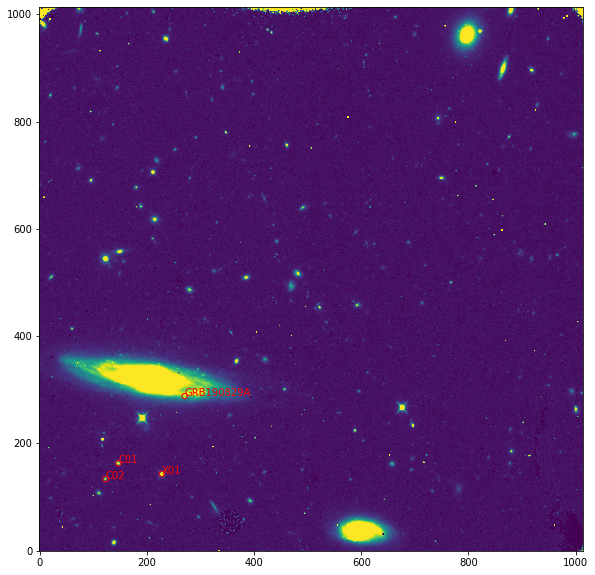

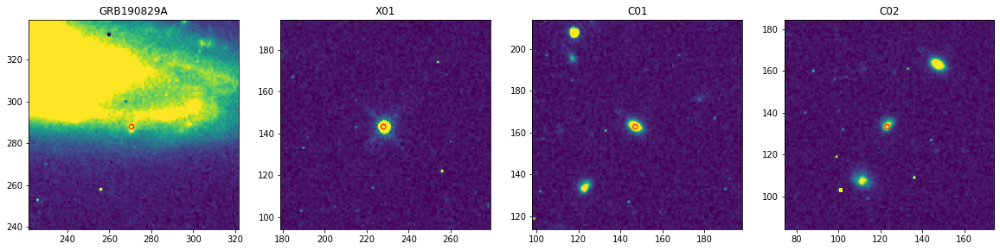

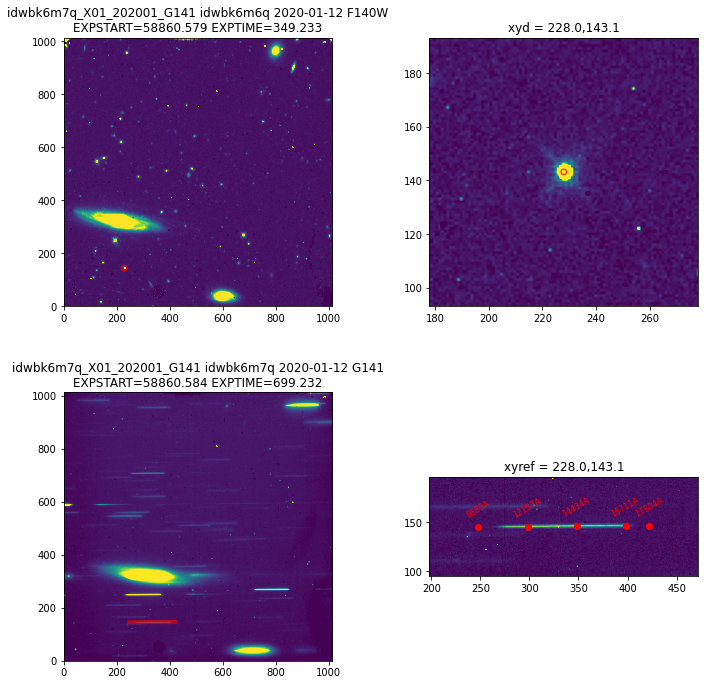

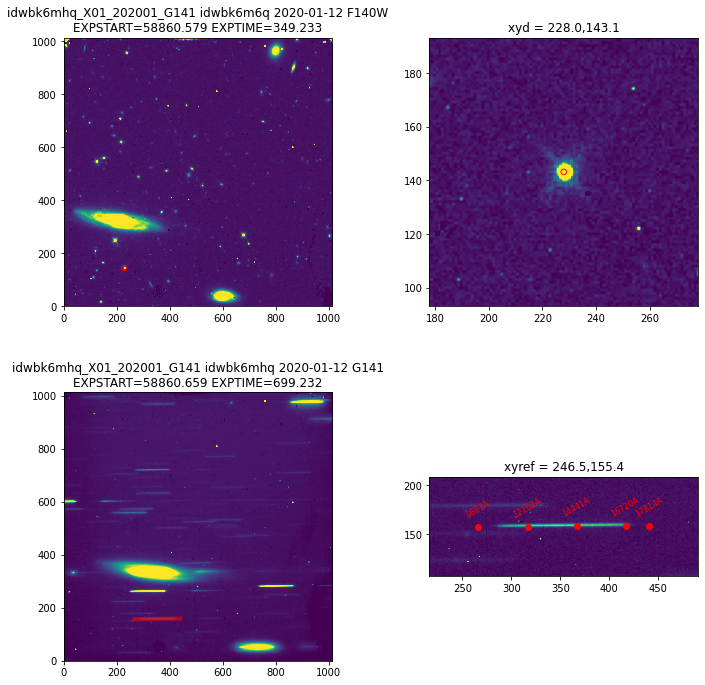

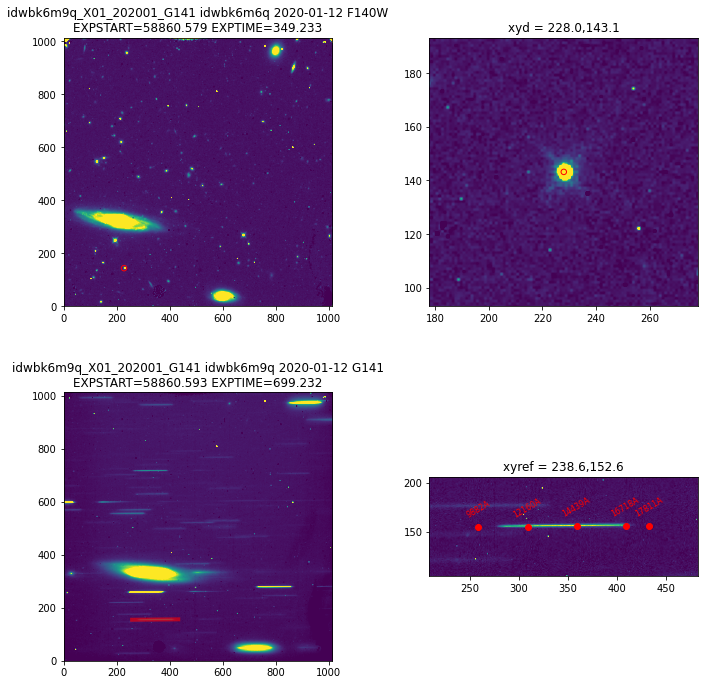

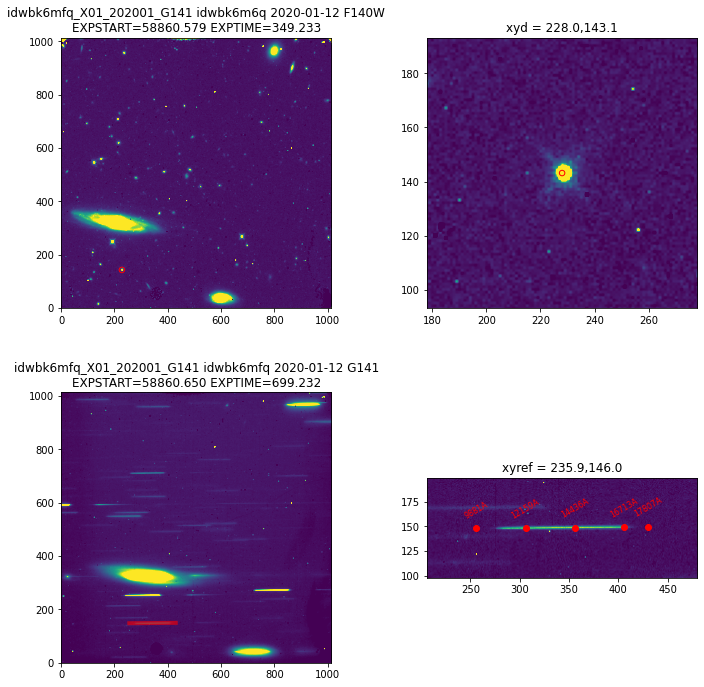

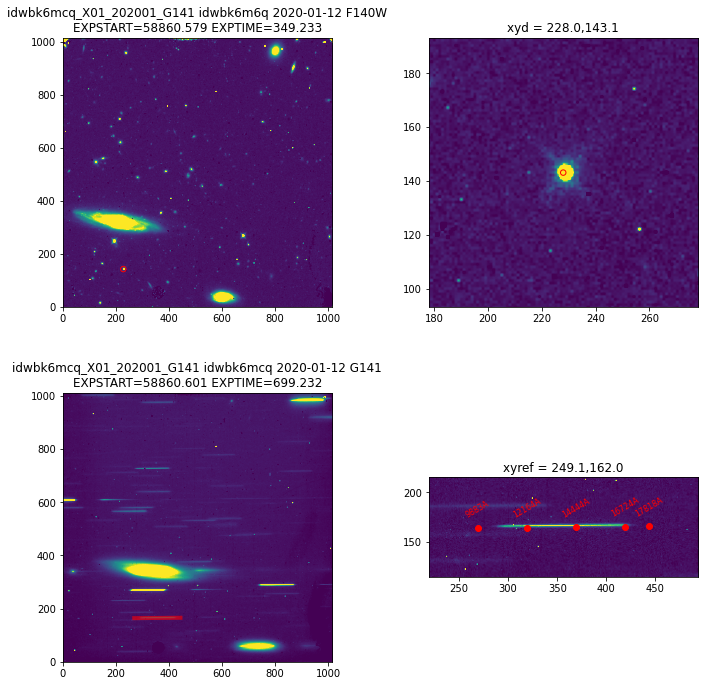

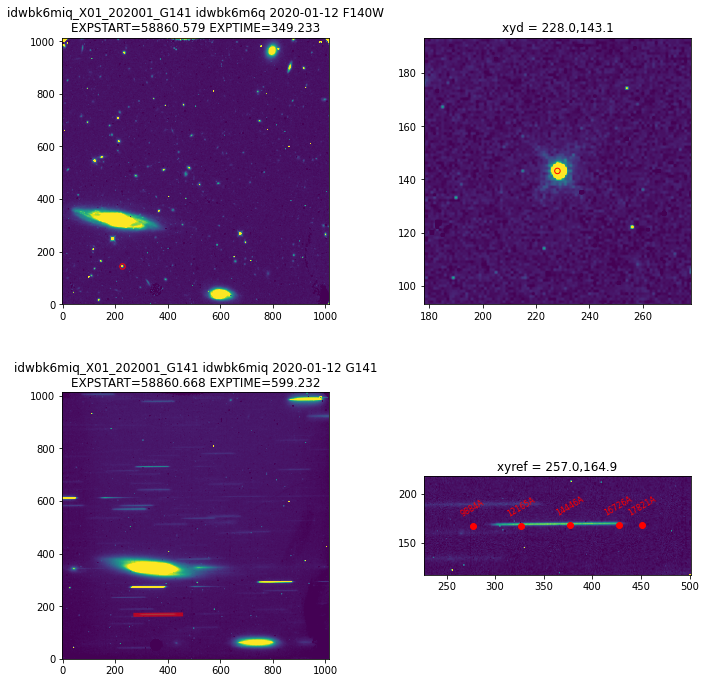

In [38]:
tmp = ds9file
sourcelist = read_ds9region(tmp)
tmpdata = fits.open(flist[0])[1].data
plt.figure(figsize=(10,10))
m = np.isfinite(tmpdata)
vmin,vmax = np.percentile(tmpdata[m],5.),np.percentile(tmpdata[m],99.)
plt.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)

for i in sourcelist:
    x,y = sourcelist[i]
    plt.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    plt.annotate(i,(x-1,y-1),fontsize=10,color='red')
    
n = len(sourcelist)
dx,dy = 50,50
fig = plt.figure(figsize=(5*n,5))
for i,ii in enumerate(sourcelist):
    x,y = sourcelist[ii]
    ax = fig.add_subplot(1,n,i+1)
    ax.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)
    ax.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    ax.set_xlim(x-dx,x+dx)
    ax.set_ylim(y-dy,y+dy)
    ax.set_title(ii,fontsize=12)
for i,ii in enumerate(flist):
    if i == 0:
        continue
    for j,jj in enumerate(sourcelist):
        if jj != sourcename:
            continue
        dfile = (flist[0],1)
        gfile = (flist[i],1)
        rootname = fits.open(gfile[0])[0].header['ROOTNAME']
        sourcename = jj
        saveprefix = '{0}_{1}'.format(rootname,identifier)
        savefolder = saveprefix
        plotformat = 'pdf'
        overwrite = False
        x,y = sourcelist[sourcename]
        xyd = (x-1,y-1)
        beam = 'A'
        params_overview = {'figsize': (10, 10), 
                           '221': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'fontsize': 12, 'title': 'default'}, 
                           '222': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'padxy': (50, 50), 'fontsize': 12, 'title': 'default'}, 
                           '223': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 4, 'alpha': 0.6, 'fontsize': 12, 'title': 'default'}, 
                           '224': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 0, 'alpha': 0.6, 'padxy': (50, 50), 'tickperx': 50, 'annotate_marker': 'ro', 'annotate_color': 'red', 'annotate_fontsize': 8, 'annotate_rotation': 30.0, 'fontsize': 12, 'title': 'default'}}
        generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                                   xyd,confile,beam,gfile,dfile,
                                   flatfile,
                               params_overview,filterobs
                                  )
# make drzlist
drzlist = []
for ii,i in enumerate(flist):
    if ii==0:
        continue
    tmp = i.split('/')[-1]
    tmpp = tmp.split('_')[0]
    string = './{0}_{1}/{2}'.format(tmpp,identifier,tmp)
    drzlist.append(string)
drzlist
# drizzle
params_drz = {'build':True,
          'restore':False,
          'overwrite':False,
          'clean':True,
          # Step 1 Statis Mask
          'static':False,
          # Step 2 Sky Sub
          'skysub':True,
          'skymethod':'localmin',
          'skystat':'median',
          # Step 3 Driz Sep
          'driz_separate':True,
          'driz_sep_kernel':'turbo',
          'driz_sep_pixfrac':1., # Set this high for CR
#           'driz_sep_scale':0.05, # Smaller than native size, better for CR
          # Step 4 Median
          'median':True,
          'combine_type':'median',
          'combine_nhigh':1, # Reject highest values before computing median, good for CR
          # Step 5 Blot
          'blot':True,
          'blot_interp':'poly5',
          'blot_addsky':True,
          # Step 6 CR
          'driz_cr':True,
          'driz_cr_corr':True,
          'driz_cr_ctegrow':0,
          # Step 7 Final Combine
          'driz_combine':True,
              'final_refimage':drzlist[0]
         }
AstroDrizzle(input=drzlist,
             output='{0}'.format(identifier),
             **params_drz
            )
# setup for drzblot
drzfile = glob.glob('./{0}_drz.fits'.format(identifier))[0]
reffile = drzlist[0]
skyval = fits.open(reffile)[1].header['MDRIZSKY']
rootname = reffile.split('/')[-1].split('_')[0]
outdata = './drzblot_{0}/{1}_drzblot_sci.fits'.format(identifier,rootname)
drzfile,reffile,skyval,outdata
# facilitate creating folder
saveprefix = rootname
savefolder = 'drzblot_{0}'.format(identifier)
plotformat = 'pdf'
overwrite = False
containter_drzblot = Container(saveprefix,savefolder,plotformat,overwrite)
# blot
ablot.blot('{0}[1]'.format(drzfile),'{0}[1]'.format(reffile),addsky=False,skyval=skyval,
           outdata=outdata,in_units='counts',out_units='cps')
# replace back
os.system('cp {0} ./{1}/'.format(flist[1],savefolder))
string = './{0}/{1}'.format(savefolder,flist[1].split('/')[-1])
tmp = fits.open(string)
tmpp = fits.open(outdata)
tmp[1].data = tmpp[1].data.copy()
tmp.writeto(string,overwrite=True)


# 6. drzblot X01 201909 G141

In [39]:
# Set files
fpath = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/*k02*/*flt.fits'
tmp = np.array(glob.glob(fpath))
tlist = tmp
tlist = [tmp[3],tmp[4],tmp[0],tmp[1],tmp[2]]
for ii,i in enumerate(tlist):
    h = fits.open(i)[0].header
    hs = fits.open(i)[1].header
    string = '{0} {1} {2} {3} {4} {5} {6} {7} {8}'.format(ii,h['ROOTNAME'],h['FILTER'],h['EXPSTART'],h['SUBARRAY'],
                       h['POSTARG1'],h['POSTARG2'],hs['IDCSCALE'],h['DATE-OBS']
                      )
    print(string)
flist = copy.deepcopy(tlist)


0 idlk02jtq F160W 58754.2023676 False 0.0 0.0 0.1282500028610229 2019-09-28
1 idlk02jwq G141 58754.20622168 False 0.0 0.0 0.1282500028610229 2019-09-28
2 idlk02k1q G141 58754.26446242 False -0.20344 0.30304 0.1282500028610229 2019-09-28
3 idlk02jyq G141 58754.2513839 False 0.54235 0.18176 0.1282500028610229 2019-09-28
4 idlk02jzq G141 58754.25792316 False 0.33891 0.48481 0.1282500028610229 2019-09-28


In [40]:
sourcename = 'X01'
confile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/G141.F160W.V4.32.conf'
flatfile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/WFC3.IR.G141.flat.2.fits'
dateobs = '201909'
filterobs = 'G141'
identifier = '{0}_{1}_{2}'.format(sourcename,dateobs,filterobs)
ds9file = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/idlk02jtq/idlk02jtq.reg'


Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_trace.csv
Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_overview.pdf

Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_tbox.csv
Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_bbox.csv
Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_bbcorner.csv
Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_cutout.fits
Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_mask.fits
Save ./idlk02jwq_X01_201909_G141/idlk02jwq_X01_201909_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk02jwq_X01_201909_G141/idlk02jwq_flt.fits
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_trace.csv
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_overview.pdf

Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_tbox.csv
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_bbox.csv
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_bbcorner.csv
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_cutout.fits
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_mask.fits
Save ./idlk02k1q_X01_201909_G141/idlk02k1q_X01_201909_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk02k1q_X01_201909_G141/idlk02k1q_flt.fits
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_trace.csv
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_overview.pdf

Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_tbox.csv
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_bbox.csv
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_bbcorner.csv
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_cutout.fits
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_mask.fits
Save ./idlk02jyq_X01_201909_G141/idlk02jyq_X01_201909_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk02jyq_X01_201909_G141/idlk02jyq_flt.fits
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_trace.csv
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_overview.pdf

Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_tbox.csv
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_bbox.csv
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_bbcorner.csv
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_cutout.fits
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_mask.fits
Save ./idlk02jzq_X01_201909_G141/idlk02jzq_X01_201909_G141_fullflat.fits
Update flatfielded ./idlk02jzq_X01_201909_G141/idlk02jzq_flt.fits
Setting up logfile :  astrodrizzle.log
AstroDrizzle Version 3.1.6 (2020-02-19 16:16:30 -0500) started at: 16

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Creating OUTPUT WCS from ./idlk02jwq_X01_201909_G141/idlk02jwq_flt.fits[1]
WCS Keywords

CD_11  CD_12: 3.55868942803283e-05 1.10065563699446e-05
CD_21  CD_22: 1.22037710827537e-05 -3.1749138970222e-05
CRVAL    : 44.54406741220054 -8.956507658833223
CRPIX    : 507.0 507.0
NAXIS    : 1014 1014
Plate Scale : 0.1354365297404927
ORIENTAT : 160.87997048501822
********************************************************************************
*
*  Estimated memory usage:  up to 78 Mb.
*  Output image size:       1014 X 1014 pixels. 
*  Output image file:       ~ 11 Mb. 
*  Cores available:         4
*
********************************************************************************
==== Processing Step Initialization finished at 16:12:48.209 (24/08/2020)
==== Processing Step  Static Mask  started at  16:12:48.211 (24/08/2020)

==== Processing Step Static Mask finished at 16:12:48.213 (24/08/2020)
==== Processing Step  Subtract Sky  started at  16:12:48.214 (24/08/2020)

***** skymatch started on 

Writing out image to disk: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk02jzq_X01_201909_G141/idlk02jzq_sci1_blt.fits
==== Processing Step Blot finished at 16:12:51.743 (24/08/2020)
==== Processing Step  Driz_CR  started at  16:12:51.744 (24/08/2020)

Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk02jwq_X01_201909_G141/idlk02jwq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk02k1q_X01_201909_G141/idlk02k1q_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk02jyq_X01_201909_G141/idlk02jyq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk02jzq_X01_201909_G141/idlk02jzq_sci1_crmask.fits
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk02jwq_X01_201909_G141/idlk02jwq_crclean.fits'
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk02k1q_X01_201909_G141/idlk02k1q_crclean.fits'
Created CR corrected file: '/Us

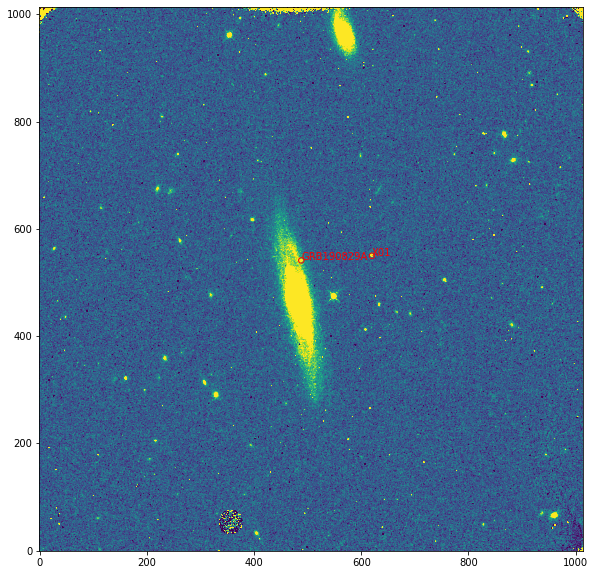

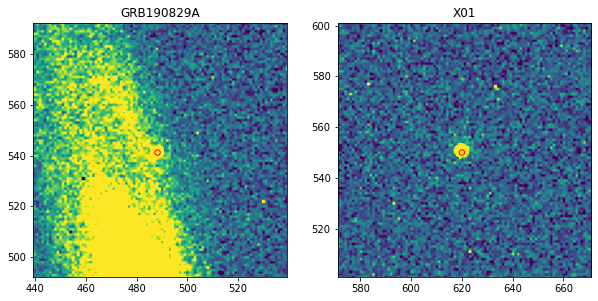

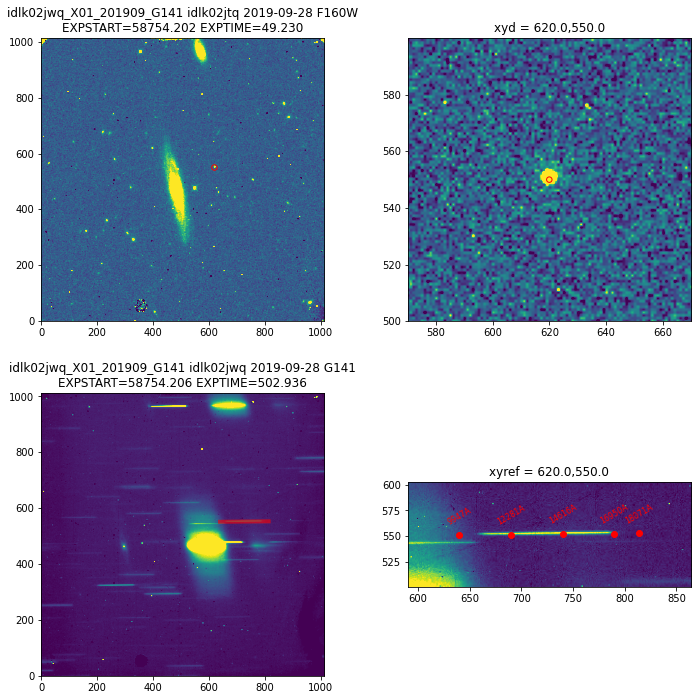

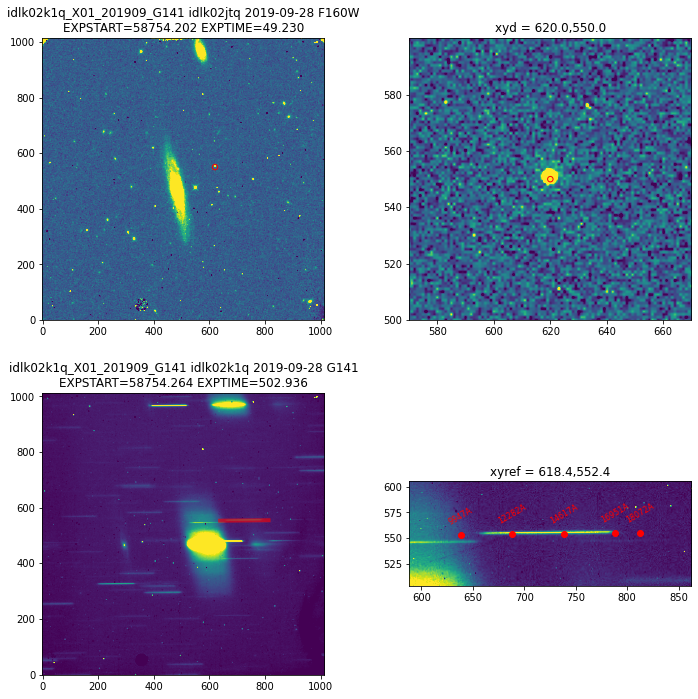

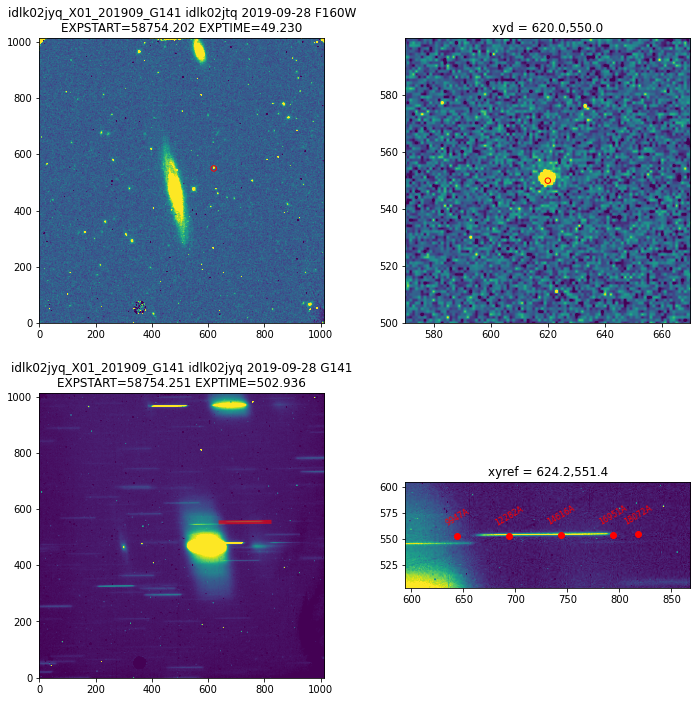

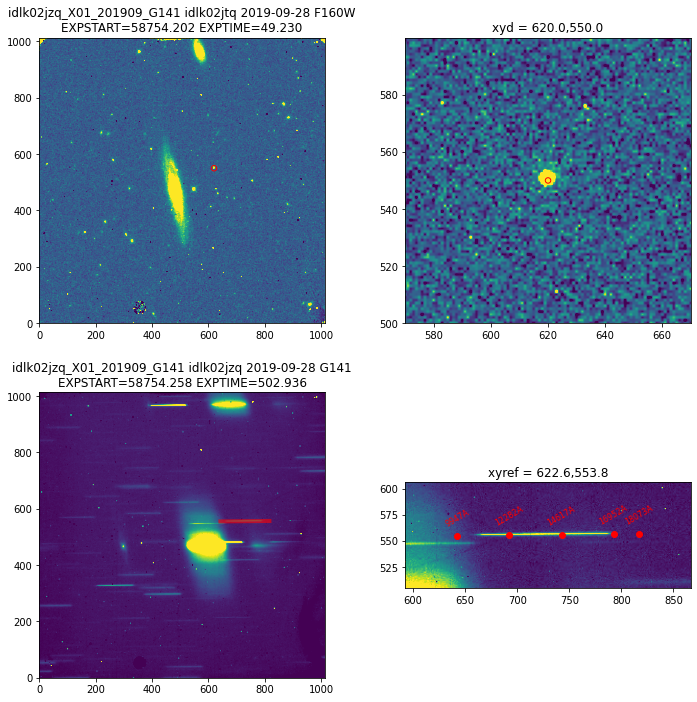

In [41]:
tmp = ds9file
sourcelist = read_ds9region(tmp)
tmpdata = fits.open(flist[0])[1].data
plt.figure(figsize=(10,10))
m = np.isfinite(tmpdata)
vmin,vmax = np.percentile(tmpdata[m],5.),np.percentile(tmpdata[m],99.)
plt.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)

for i in sourcelist:
    x,y = sourcelist[i]
    plt.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    plt.annotate(i,(x-1,y-1),fontsize=10,color='red')
    
n = len(sourcelist)
dx,dy = 50,50
fig = plt.figure(figsize=(5*n,5))
for i,ii in enumerate(sourcelist):
    x,y = sourcelist[ii]
    ax = fig.add_subplot(1,n,i+1)
    ax.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)
    ax.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    ax.set_xlim(x-dx,x+dx)
    ax.set_ylim(y-dy,y+dy)
    ax.set_title(ii,fontsize=12)
for i,ii in enumerate(flist):
    if i == 0:
        continue
    for j,jj in enumerate(sourcelist):
        if jj != sourcename:
            continue
        dfile = (flist[0],1)
        gfile = (flist[i],1)
        rootname = fits.open(gfile[0])[0].header['ROOTNAME']
        sourcename = jj
        saveprefix = '{0}_{1}'.format(rootname,identifier)
        savefolder = saveprefix
        plotformat = 'pdf'
        overwrite = False
        x,y = sourcelist[sourcename]
        xyd = (x-1,y-1)
        beam = 'A'
        params_overview = {'figsize': (10, 10), 
                           '221': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'fontsize': 12, 'title': 'default'}, 
                           '222': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'padxy': (50, 50), 'fontsize': 12, 'title': 'default'}, 
                           '223': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 4, 'alpha': 0.6, 'fontsize': 12, 'title': 'default'}, 
                           '224': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 0, 'alpha': 0.6, 'padxy': (50, 50), 'tickperx': 50, 'annotate_marker': 'ro', 'annotate_color': 'red', 'annotate_fontsize': 8, 'annotate_rotation': 30.0, 'fontsize': 12, 'title': 'default'}}
        generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                                   xyd,confile,beam,gfile,dfile,
                                   flatfile,
                               params_overview,filterobs
                                  )
# make drzlist
drzlist = []
for ii,i in enumerate(flist):
    if ii==0:
        continue
    tmp = i.split('/')[-1]
    tmpp = tmp.split('_')[0]
    string = './{0}_{1}/{2}'.format(tmpp,identifier,tmp)
    drzlist.append(string)
drzlist
# drizzle
params_drz = {'build':True,
          'restore':False,
          'overwrite':False,
          'clean':True,
          # Step 1 Statis Mask
          'static':False,
          # Step 2 Sky Sub
          'skysub':True,
          'skymethod':'localmin',
          'skystat':'median',
          # Step 3 Driz Sep
          'driz_separate':True,
          'driz_sep_kernel':'turbo',
          'driz_sep_pixfrac':1., # Set this high for CR
#           'driz_sep_scale':0.05, # Smaller than native size, better for CR
          # Step 4 Median
          'median':True,
          'combine_type':'median',
          'combine_nhigh':1, # Reject highest values before computing median, good for CR
          # Step 5 Blot
          'blot':True,
          'blot_interp':'poly5',
          'blot_addsky':True,
          # Step 6 CR
          'driz_cr':True,
          'driz_cr_corr':True,
          'driz_cr_ctegrow':0,
          # Step 7 Final Combine
          'driz_combine':True,
              'final_refimage':drzlist[0]
         }
AstroDrizzle(input=drzlist,
             output='{0}'.format(identifier),
             **params_drz
            )
# setup for drzblot
drzfile = glob.glob('./{0}_drz.fits'.format(identifier))[0]
reffile = drzlist[0]
skyval = fits.open(reffile)[1].header['MDRIZSKY']
rootname = reffile.split('/')[-1].split('_')[0]
outdata = './drzblot_{0}/{1}_drzblot_sci.fits'.format(identifier,rootname)
drzfile,reffile,skyval,outdata
# facilitate creating folder
saveprefix = rootname
savefolder = 'drzblot_{0}'.format(identifier)
plotformat = 'pdf'
overwrite = False
containter_drzblot = Container(saveprefix,savefolder,plotformat,overwrite)
# blot
ablot.blot('{0}[1]'.format(drzfile),'{0}[1]'.format(reffile),addsky=False,skyval=skyval,
           outdata=outdata,in_units='counts',out_units='cps')
# replace back
os.system('cp {0} ./{1}/'.format(flist[1],savefolder))
string = './{0}/{1}'.format(savefolder,flist[1].split('/')[-1])
tmp = fits.open(string)
tmpp = fits.open(outdata)
tmp[1].data = tmpp[1].data.copy()
tmp.writeto(string,overwrite=True)


# 7. drzblot X01 201910 G141

In [42]:
# Set files
fpath = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/*k04*/*flt.fits'
tmp = np.array(glob.glob(fpath))
tlist = tmp
tlist = [tmp[5],tmp[6],tmp[0],tmp[1],tmp[3]]
for ii,i in enumerate(tlist):
    h = fits.open(i)[0].header
    hs = fits.open(i)[1].header
    string = '{0} {1} {2} {3} {4} {5} {6} {7} {8}'.format(ii,h['ROOTNAME'],h['FILTER'],h['EXPSTART'],h['SUBARRAY'],
                       h['POSTARG1'],h['POSTARG2'],hs['IDCSCALE'],h['DATE-OBS']
                      )
    print(string)
flist = copy.deepcopy(tlist)


0 idlk04b9q F160W 58782.72051658 False 0.0 0.0 0.1282500028610229 2019-10-26
1 idlk04bcq G141 58782.72437065 False 0.0 0.0 0.1282500028610229 2019-10-26
2 idlk04beq G141 58782.73090991 False 0.54235 0.18176 0.1282500028610229 2019-10-26
3 idlk04bfq G141 58782.73744954 False 0.33891 0.48481 0.1282500028610229 2019-10-26
4 idlk04bhq G141 58782.7439888 False -0.20344 0.30304 0.1282500028610229 2019-10-26


In [43]:
sourcename = 'X01'
confile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/G141.F160W.V4.32.conf'
flatfile = '/Users/kbhirombhakdi/_work/_calib_files/WFC3.IR.G141.cal.V4.32/WFC3.IR.G141.flat.2.fits'
dateobs = '201910'
filterobs = 'G141'
identifier = '{0}_{1}_{2}'.format(sourcename,dateobs,filterobs)
ds9file = '/Users/kbhirombhakdi/_work/_data/15089/mastDownload/HST/idlk04b9q/idlk04b9q.reg'


Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_trace.csv
Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_overview.pdf

Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_tbox.csv
Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_bbox.csv
Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_bbcorner.csv
Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_cutout.fits
Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_mask.fits
Save ./idlk04bcq_X01_201910_G141/idlk04bcq_X01_201910_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk04bcq_X01_201910_G141/idlk04bcq_flt.fits
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_trace.csv
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_overview.pdf

Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_tbox.csv
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_bbox.csv
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_bbcorner.csv
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_cutout.fits
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_mask.fits
Save ./idlk04beq_X01_201910_G141/idlk04beq_X01_201910_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk04beq_X01_201910_G141/idlk04beq_flt.fits
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_trace.csv
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_overview.pdf

Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_tbox.csv
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_bbox.csv
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_bbcorner.csv
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_cutout.fits
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_mask.fits
Save ./idlk04bfq_X01_201910_G141/idlk04bfq_X01_201910_G141_fullflat.fits


/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Update flatfielded ./idlk04bfq_X01_201910_G141/idlk04bfq_flt.fits
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_xyref.csv
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Rescale = False
Perform compute
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_trace.csv
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_overview.pdf

Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_tbox.csv
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_bbox.csv
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_bbcorner.csv
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_cutout.fits
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_mask.fits
Save ./idlk04bhq_X01_201910_G141/idlk04bhq_X01_201910_G141_fullflat.fits
Update flatfielded ./idlk04bhq_X01_201910_G141/idlk04bhq_flt.fits
Setting up logfile :  astrodrizzle.log
AstroDrizzle Version 3.1.6 (2020-02-19 16:16:30 -0500) started at: 16

/Users/kbhirombhakdi/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:107: RuntimeWarning: invalid value encountered in true_divide


Creating OUTPUT WCS from ./idlk04bcq_X01_201910_G141/idlk04bcq_flt.fits[1]
WCS Keywords

CD_11  CD_12: 3.6387202143166e-05 8.643391617509e-06
CD_21  CD_22: 9.5553146949383e-06 -3.2471875449685e-05
CRVAL    : 44.54419956354905 -8.956511304615452
CRPIX    : 507.0 507.0
NAXIS    : 1014 1014
Plate Scale : 0.1354352592300136
ORIENTAT : 165.0945728804626
********************************************************************************
*
*  Estimated memory usage:  up to 78 Mb.
*  Output image size:       1014 X 1014 pixels. 
*  Output image file:       ~ 11 Mb. 
*  Cores available:         4
*
********************************************************************************
==== Processing Step Initialization finished at 16:20:56.262 (24/08/2020)
==== Processing Step  Static Mask  started at  16:20:56.264 (24/08/2020)

==== Processing Step Static Mask finished at 16:20:56.267 (24/08/2020)
==== Processing Step  Subtract Sky  started at  16:20:56.268 (24/08/2020)

***** skymatch started on 2020-

Writing out image to disk: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk04bhq_X01_201910_G141/idlk04bhq_sci1_blt.fits
==== Processing Step Blot finished at 16:20:59.765 (24/08/2020)
==== Processing Step  Driz_CR  started at  16:20:59.766 (24/08/2020)

Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk04bcq_X01_201910_G141/idlk04bcq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk04beq_X01_201910_G141/idlk04beq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk04bfq_X01_201910_G141/idlk04bfq_sci1_crmask.fits
Creating output: /Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk04bhq_X01_201910_G141/idlk04bhq_sci1_crmask.fits
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk04bcq_X01_201910_G141/idlk04bcq_crclean.fits'
Created CR corrected file: '/Users/kbhirombhakdi/_work/Sidekicks/20200824/idlk04beq_X01_201910_G141/idlk04beq_crclean.fits'
Created CR corrected file: '/Us

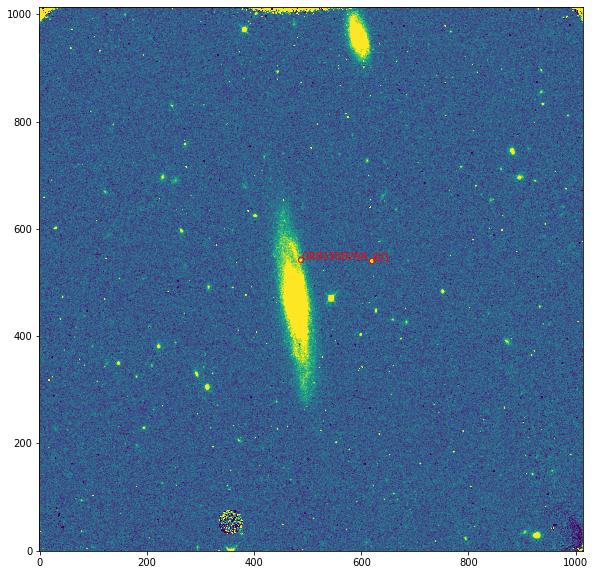

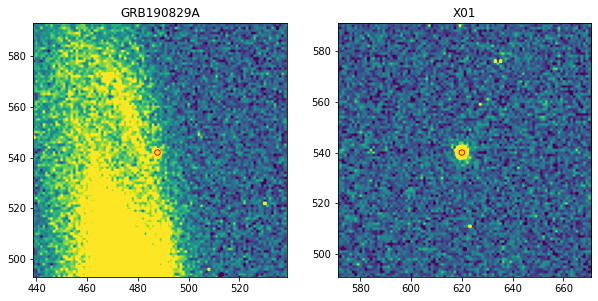

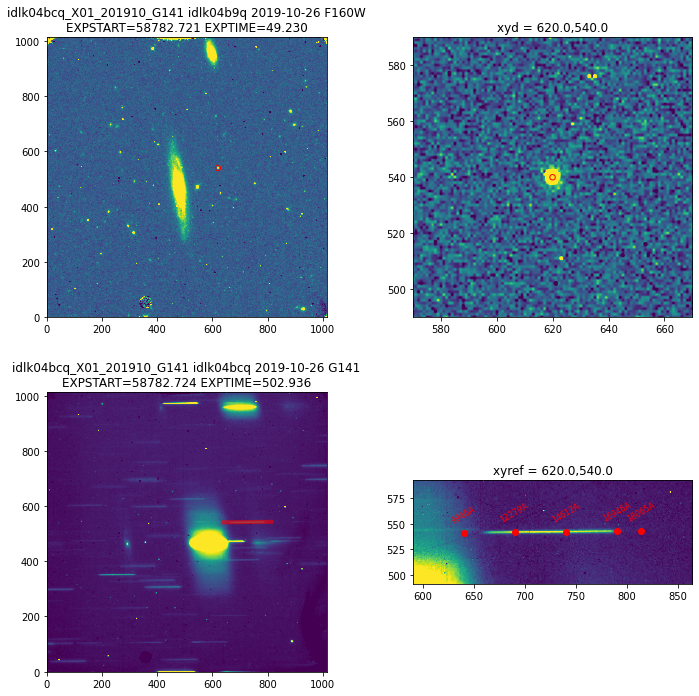

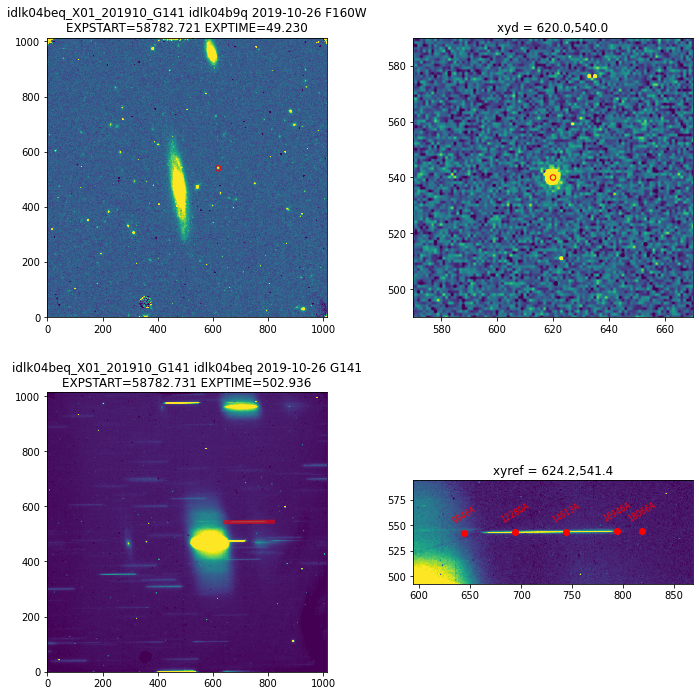

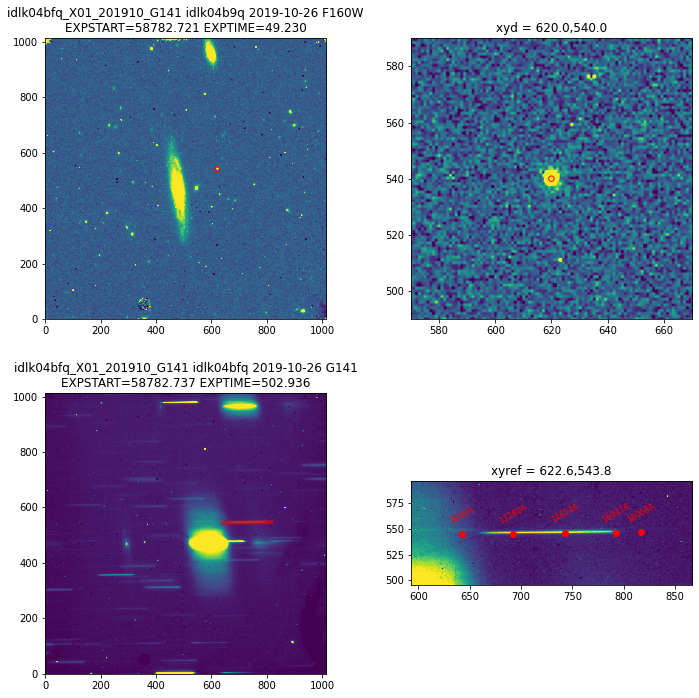

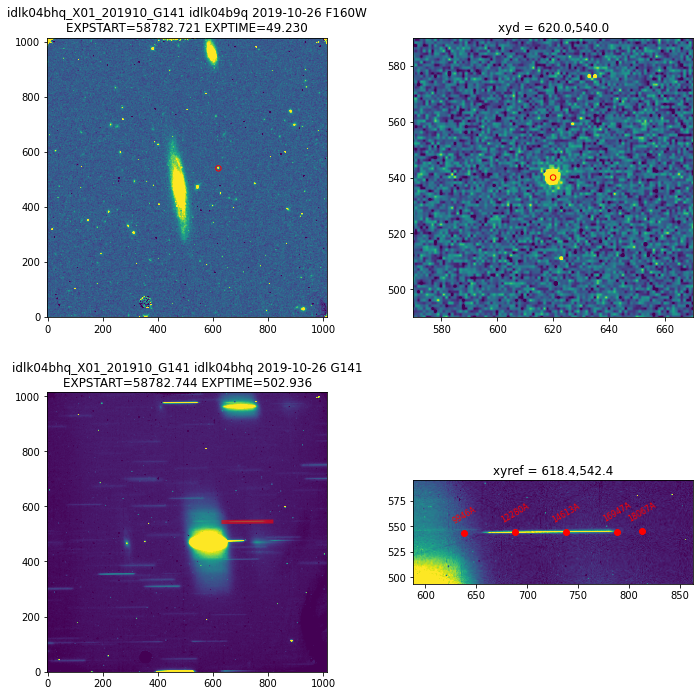

In [44]:
tmp = ds9file
sourcelist = read_ds9region(tmp)
tmpdata = fits.open(flist[0])[1].data
plt.figure(figsize=(10,10))
m = np.isfinite(tmpdata)
vmin,vmax = np.percentile(tmpdata[m],5.),np.percentile(tmpdata[m],99.)
plt.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)

for i in sourcelist:
    x,y = sourcelist[i]
    plt.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    plt.annotate(i,(x-1,y-1),fontsize=10,color='red')
    
n = len(sourcelist)
dx,dy = 50,50
fig = plt.figure(figsize=(5*n,5))
for i,ii in enumerate(sourcelist):
    x,y = sourcelist[ii]
    ax = fig.add_subplot(1,n,i+1)
    ax.imshow(tmpdata,origin='lower',cmap='viridis',vmin=vmin,vmax=vmax)
    ax.scatter(x-1,y-1,s=30,edgecolor='red',facecolor='None',label=i)
    ax.set_xlim(x-dx,x+dx)
    ax.set_ylim(y-dy,y+dy)
    ax.set_title(ii,fontsize=12)
for i,ii in enumerate(flist):
    if i == 0:
        continue
    for j,jj in enumerate(sourcelist):
        if jj != sourcename:
            continue
        dfile = (flist[0],1)
        gfile = (flist[i],1)
        rootname = fits.open(gfile[0])[0].header['ROOTNAME']
        sourcename = jj
        saveprefix = '{0}_{1}'.format(rootname,identifier)
        savefolder = saveprefix
        plotformat = 'pdf'
        overwrite = False
        x,y = sourcelist[sourcename]
        xyd = (x-1,y-1)
        beam = 'A'
        params_overview = {'figsize': (10, 10), 
                           '221': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'fontsize': 12, 'title': 'default'}, 
                           '222': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'padxy': (50, 50), 'fontsize': 12, 'title': 'default'}, 
                           '223': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 4, 'alpha': 0.6, 'fontsize': 12, 'title': 'default'}, 
                           '224': {'minmax': (5.0, 99.0), 'cmap': 'viridis', 's': 30, 'facecolor': 'None', 'edgecolor': 'red', 'color': 'red', 'ls': '-', 'lw': 0, 'alpha': 0.6, 'padxy': (50, 50), 'tickperx': 50, 'annotate_marker': 'ro', 'annotate_color': 'red', 'annotate_fontsize': 8, 'annotate_rotation': 30.0, 'fontsize': 12, 'title': 'default'}}
        generate_flatfield_flt(saveprefix,savefolder,plotformat,overwrite,
                                   xyd,confile,beam,gfile,dfile,
                                   flatfile,
                               params_overview,filterobs
                                  )
# make drzlist
drzlist = []
for ii,i in enumerate(flist):
    if ii==0:
        continue
    tmp = i.split('/')[-1]
    tmpp = tmp.split('_')[0]
    string = './{0}_{1}/{2}'.format(tmpp,identifier,tmp)
    drzlist.append(string)
drzlist
# drizzle
params_drz = {'build':True,
          'restore':False,
          'overwrite':False,
          'clean':True,
          # Step 1 Statis Mask
          'static':False,
          # Step 2 Sky Sub
          'skysub':True,
          'skymethod':'localmin',
          'skystat':'median',
          # Step 3 Driz Sep
          'driz_separate':True,
          'driz_sep_kernel':'turbo',
          'driz_sep_pixfrac':1., # Set this high for CR
#           'driz_sep_scale':0.05, # Smaller than native size, better for CR
          # Step 4 Median
          'median':True,
          'combine_type':'median',
          'combine_nhigh':1, # Reject highest values before computing median, good for CR
          # Step 5 Blot
          'blot':True,
          'blot_interp':'poly5',
          'blot_addsky':True,
          # Step 6 CR
          'driz_cr':True,
          'driz_cr_corr':True,
          'driz_cr_ctegrow':0,
          # Step 7 Final Combine
          'driz_combine':True,
              'final_refimage':drzlist[0]
         }
AstroDrizzle(input=drzlist,
             output='{0}'.format(identifier),
             **params_drz
            )
# setup for drzblot
drzfile = glob.glob('./{0}_drz.fits'.format(identifier))[0]
reffile = drzlist[0]
skyval = fits.open(reffile)[1].header['MDRIZSKY']
rootname = reffile.split('/')[-1].split('_')[0]
outdata = './drzblot_{0}/{1}_drzblot_sci.fits'.format(identifier,rootname)
drzfile,reffile,skyval,outdata
# facilitate creating folder
saveprefix = rootname
savefolder = 'drzblot_{0}'.format(identifier)
plotformat = 'pdf'
overwrite = False
containter_drzblot = Container(saveprefix,savefolder,plotformat,overwrite)
# blot
ablot.blot('{0}[1]'.format(drzfile),'{0}[1]'.format(reffile),addsky=False,skyval=skyval,
           outdata=outdata,in_units='counts',out_units='cps')
# replace back
os.system('cp {0} ./{1}/'.format(flist[1],savefolder))
string = './{0}/{1}'.format(savefolder,flist[1].split('/')[-1])
tmp = fits.open(string)
tmpp = fits.open(outdata)
tmp[1].data = tmpp[1].data.copy()
tmp.writeto(string,overwrite=True)


# Summary
We generated drzblot images of X01 from all epochs including both G102 and G141. 